<a href="https://colab.research.google.com/github/Vl-Leschinskii/jokes_topics/blob/main/Anekdot_for_all.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Нужные установки

In [ ]:
!pip3 install pyLDAvis

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
!pip install transformers sentencepiece

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import sys
!{sys.executable} -m pip install --upgrade pymorphy2

from pymorphy2 import MorphAnalyzer

parser = MorphAnalyzer()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/pymorphy2/units/base.py:70: DeprecationWarning: inspect.getargspec() is deprecated since Python 3.0, use inspect.signature() or inspect.getfullargspec()
  args, varargs, kw, default = inspect.getargspec(cls.__init__)
/usr/local/lib/python3.10/dist-packages/pymorphy2/units/base.py:70: DeprecationWarning: inspect.getargspec() is deprecated since Python 3.0, use inspect.signature() or inspect.getfullargspec()
  args, varargs, kw, default = inspect.getargspec(cls.__init__)
/usr/local/lib/python3.10/dist-packages/pymorphy2/units/base.py:70: DeprecationWarning: inspect.getargspec() is deprecated since Python 3.0, use inspect.signature() or inspect.getfullargspec()
  args, varargs, kw, default = inspect.getargspec(cls.__init__)
/usr/local/lib/python3.10/dist-packages/pymorphy2/units/base.py:70: DeprecationWarning: inspect.getargspec() is deprecated since Python 3.0, use inspect.signature() or inspect.getfullargspec()
  args, varargs, kw, default = inspe

In [ ]:
import re

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import pandas as pd              # Пакет для работы с таблицами
import numpy as np               # Пакет для работы с векторами и матрицами
import matplotlib.pyplot as plt  # Пакет для строительства графиков
import seaborn as sns            # Еще один пакет для графиков
import pickle                    # Пакет для подгрузки данных специфического для питона формата

#from dateutil.relativedelta import relativedelta # еще один пакет для работы с временем
from wordcloud import WordCloud  # Пакет для построения облаков слов

plt.style.use('ggplot')          # задаём красивый стиль для графиков matplotlib-а
%matplotlib inline

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF, LatentDirichletAllocation
import os
import requests
from pathlib import Path
import nltk
from nltk import sent_tokenize, word_tokenize, regexp_tokenize
from collections import Counter
from nltk.corpus import stopwords as nltk_stopwords
from nltk.tokenize import word_tokenize
from nltk import download as nltk_download

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Функции

In [ ]:
def embed_bert_cls(text, model, tokenizer):
#    t = tokenizer(text, padding=True, truncation=True, return_tensors='pt')
    t = tokenizer(text, padding=True, truncation=False, return_tensors='pt')

    with torch.no_grad():
        model_output = model(**{k: v.to(model.device) for k, v in t.items()})
    embeddings = model_output.last_hidden_state[:, 0, :]
    embeddings = torch.nn.functional.normalize(embeddings)
    return embeddings[0].cpu().numpy()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def similarity(v1, v2):
    n1 = np.linalg.norm(v1)
    n2 = np.linalg.norm(v2)

    if n1 < 1e-6 or n2 < 1e-6:
        return 0.0
    else:
        return np.dot(v1, v2) / n1 / n2

def word_similarity(model, w1, w2):
    return similarity(model.get_word_vector(w1), model.get_word_vector(w2))

def sentence_similarity(model, t1, t2):
    return similarity(model.get_sentence_vector(t1), model.get_sentence_vector(t2))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def display_topics_old(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
      print("Topic %d:" % (topic_idx))
      print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def display_topics(model, feature_names, no_top_words):
    topic_list=[]
    topic_list_2=[]
    no_top_words=1000
    for topic_idx, topics in enumerate(model.components_):
      sort_topix=topics.argsort()[:-no_top_words - 1:-1]
      to_idx=[topic_idx]
      top_list=[]
      print("Topic %d:" % (topic_idx))
      line=[]
      for i in sort_topix:
        top_list=[]
        top_list.append(topic_idx)
        top_list.append(feature_names[i])
        top_list.append(topics[i])
        topic_list.append(top_list)
        line.append(feature_names[i])
     # to_idx.append(topic_list)
      print(line[:10])
  #  topic_list_2.append(to_idx)
#        print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))
    return pd.DataFrame(topic_list,columns=['topic','topic_word','topic_val'])#,topic_list_2

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# облако слов топиков для модели gensim
def plotWordCloud(topic_number,topics,head):
    """
        Строит визуализацию слов на основе текстов топиков из Gensim
    """
    # получаем частоты и слова топика
    text = dict(topics[topic_number][1])
    #print(head+str(topic_number))
    # строим облако слов
    wordcloud = WordCloud(background_color="white", max_words=100, width=900, height=900, collocations=False)
    wordcloud = wordcloud.generate_from_frequencies(text)
#    wordcloud.generate(long_string)
    plt.figure(figsize=(15, 10))
    plt.title((head+" номер {}").format(topic_number))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off");

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# облако слов топиков для модели sklearn
def plotWordCloud_2(topic_number,topics):
    """
        Строит визуализацию слов на основе текстов топиков из Sklearn
    """
    # получаем частоты и слова топика

#    text = dict(topics[topic_number][1])
    topic=topic_number
    words=topics[topics['topic']==topic]['topic_word'].values.astype('U')
    long_string =','.join(words)
    # строим облако слов
    wordcloud = WordCloud(background_color="white", max_words=100, width=900, height=900, collocations=False)
  #  wordcloud = wordcloud.generate_from_frequencies(long_string)
    wordcloud.generate(long_string)
    plt.figure(figsize=(15, 10))
    plt.title("Топик номер {}".format(topic_number))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off");

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import requests

url = "https://raw.githubusercontent.com/dhhse/dh2020/master/data/stop_ru.txt"
response = requests.get(url)

if response.status_code == 200:
    with open("stop_ru.txt", "wb") as file:
        file.write(response.content)
    print("Файл успешно загружен.")
else:
    print("Ошибка при загрузке файла:", response.status_code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Файл успешно загружен.


In [ ]:
import nltk
nltk.download("punkt")


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
# import spacy

# # Установка модели для русского языка
# nlp = spacy.load("ru_core_news_sm")

# doc = nlp("Я люблю программировать.")
# tokens = [token.text for token in doc]
# print(tokens)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# import nltk
# nltk.download("punkt")

# # Загрузка файла
# !wget https://raw.githubusercontent.com/dhhse/dh2020/master/data/stop_ru.txt

# # Проверка, что файл загружен
# !ls  # Убедитесь, что файл stop_ru.txt существует

# # Чтение файла
# url = "https://raw.githubusercontent.com/dhhse/dh2020/master/data/stop_ru.txt"
# with open("stop_ru.txt", "r", encoding="utf-8") as stop_ru:
#     rus_stops = [word.strip() for word in stop_ru.readlines()]

# # Определение знаков препинания
# punctuation = '!\"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~—»«...–'
# filter_token = rus_stops + list(punctuation)

# # Импорт pymorphy2
# from pymorphy2 import MorphAnalyzer
# parser = MorphAnalyzer()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
nltk_download("punkt")
from pymorphy2 import MorphAnalyzer

# !wget https://raw.githubusercontent.com/dhhse/dh2020/master/data/stop_ru.txt
url = "https://raw.githubusercontent.com/dhhse/dh2020/master/data/stop_ru.txt"

with open ("stop_ru.txt", "r") as stop_ru:
    rus_stops = [word.strip() for word in stop_ru.readlines()]
punctuation = '!\"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~—»«...–'
filter_token = rus_stops + list (punctuation)
from pymorphy2 import MorphAnalyzer
import importlib
# importlib.reload(MorphAnalyzer)

parser = MorphAnalyzer()

def preprocess_sklearn(input_text):
    text = input_text.lower()
    tokenized_text = word_tokenize(text)
    clean_text = [word for word in tokenized_text if word not in filter_token]
    lemmatized_text = [parser.parse(word)[0].normal_form for word in clean_text]
    out_text = " ".join(lemmatized_text)
    return out_text

def preprocess_gemsim(input_text):
    text = input_text.lower()
    tokenized_text = word_tokenize(text)
    clean_text = [word for word in tokenized_text if word not in filter_token]
    lemmatized_text = [parser.parse(word)[0].normal_form for word in clean_text]
    return lemmatized_text

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<>:9: DeprecationWarning: invalid escape sequence '\]'
<>:9: DeprecationWarning: invalid escape sequence '\]'
<ipython-input-90-9d74d188d6f2>:9: DeprecationWarning: invalid escape sequence '\]'
  punctuation = '!\"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~—»«...–'
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
/usr/local/lib/python3.10/dist-packages/pymorphy2/units/base.py:70: DeprecationWarning: inspect.getargspec() is deprecated since Python 3.0, use inspect.signature() or inspect.getfullargspec()
  args, varargs, kw, default = inspect.getargspec(cls.__init__)
/usr/local/lib/python3.

In [ ]:
def get_topic(words, lda):
    """
    """
    bag = lda.id2word.doc2bow(words)
    topics = lda.get_document_topics(bag)
    topic_dictionary = {}
    for topic in topics:
        topic_dictionary[topic[1]] = str((topic[0]))
    main_probability = max(topic_dictionary)
    main_topic = topic_dictionary[main_probability]
    return [main_topic, main_probability]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def lda_model_gensim(corpus,dictionary,num_topics):
  ldamodel = models.ldamodel.LdaModel(
    corpus,
    id2word=dictionary,
    eval_every=20,
    num_topics=num_topics,
    passes=5
    )
  return ldamodel

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def topic_file(topics_gensim_np,file_name):
  list_topic=[]
  for ind_topiс,topiс in enumerate(topics_gensim_np):
    list_word=topiс[1]
    for words in list_word:
      topic_word=[]
      topic_word.append(ind_topiс)
      topic_word.append(words[0])
      topic_word.append(words[1])
      list_topic.append(topic_word)
  topic_gensim=pd.DataFrame(list_topic,columns=['topic','word_in topic','weght_topic'])
  topic_gensim.to_csv(file_name+'.csv',index=False)
  return topic_gensim

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def topics_max(mod_data,model):
  top_n=[]
  for i in range(mod_data.shape[0]):
#for i in range(100):
    top_max=[]
    topic_list=model.transform(tfidf[i,:])
    top_max.append(np.max(topic_list))
    top_max.append(np.argmax(topic_list))
    top_n.append(top_max)
  return np.array(top_n)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
#nltk.download("stopwords") # поддерживает удаление стоп-слов
#nltk.download('wordnet') # проводит лемматизацию

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def topics_max(mod_data,model):
  top_n=[]
  for i in range(mod_data.shape[0]):
#for i in range(100):
    top_max=[]
    topic_list=model.transform(tfidf[i,:])
    top_max.append(np.max(topic_list))
    top_max.append(np.argmax(topic_list))
    top_n.append(top_max)
  return np.array(top_n)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import plotly.express as px

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Импорт данных

In [ ]:
with open("/content/drive/MyDrive/Anik_search/anek_utf8.txt", "r") as file1:
    # итерация по строкам
  n=0
  lines=[]
  for line in file1:
    if line>" ":
      lines.append(line[:-2])
      n=n+1
#  print(n)
  line_new=[]
for n in range(len(lines)-1):
  if lines[n][:15]=='<|startoftext|>':
    if lines[n+1][:15]!='<|startoftext|>':
      line_new.append(lines[n][15:]+' '+lines[n+1][15:])
    else:
      line_new.append(lines[n][15:])
ds_line=pd.DataFrame(line_new,columns=['text_base'])

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Обрабока текста

Проведем токенизацию и лемматизацию текста с помощью библиотеки pymorphy2. С помощью нее можно приводить слова в начальную форму. Получим данные для формирования "мешка слов".

In [ ]:
import nltk
nltk.download('punkt')
nltk.download('punkt_tab')




/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

In [ ]:
import nltk
nltk.download('punkt')

ds_line["text_processed_new"] = ds_line["text_base"].apply(lambda text: preprocess_sklearn(text))
ds_line["text_processed"] = ds_line["text_base"].apply(lambda text: preprocess_gemsim(text))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
ds_line.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,text_base,text_processed_new,text_processed
0,"Сразу после окончания Прямой линии, Путин пожа...",сразу окончание прямой линия путин пожаловатьс...,"[сразу, окончание, прямой, линия, путин, пожал..."
1,Это Аркадий. Аркадий попал в армию через посте...,аркадий аркадий попасть армия постель проспать...,"[аркадий, аркадий, попасть, армия, постель, пр..."
2,Толкучка в атобусе. Автобус резко тормозит и ж...,толкучка атобуса автобус резко тормозить женщи...,"[толкучка, атобуса, автобус, резко, тормозить,..."
3,"Интересно, гадалка уже догадалась, что я еду к...",интересно гадалка догадаться еда чертаново бух...,"[интересно, гадалка, догадаться, еда, чертанов..."
4,"Идет одна бабка, на встречу другой и видит, чт...",идти один бабка встреча видеть тот полный сумк...,"[идти, один, бабка, встреча, видеть, тот, полн..."


Сохраним данные для дальнейшей работы

In [ ]:
ds_line['text_base'].to_csv('anekdot_texts.csv',index=False, index_label=False)
ds_line.to_csv('anekdot_pr.csv',index=False, index_label=False)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Использование предобработанных данных для мешка слов (BOW)

In [ ]:
import gensim
from gensim import corpora, models
from ast import literal_eval
ds_line = pd.read_csv('anekdot_pr.csv',converters={"text_processed": literal_eval})

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Словарь непосредствено из (bag of words) BOW

In [ ]:
dictionary = gensim.corpora.Dictionary(ds_line["text_processed"].values) # составляем словарь из терминов
print('Размер словаря до фильтрации: {}'.format(len(dictionary)))
#gensim_dictionary.filter_extremes(no_above=0.1, no_below=20)
dictionary.filter_extremes(no_below=3, no_above=0.4, keep_n=3*10**6) # практически не фильтрует
#dictionary.filter_extremes(no_above=0.1, no_below=20)

dictionary.compactify()
print('Размер словаря после фильтрации: {}'.format(len(dictionary)))
print(dictionary)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Размер словаря до фильтрации: 70843
Размер словаря после фильтрации: 25807
Dictionary<25807 unique tokens: ['актуальный', 'бог', 'вопрос', 'дефицит', 'дзюба']...>


### Создаем корпус

In [ ]:
corpus = [dictionary.doc2bow(text) for text in ds_line['text_processed']]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Получение словаря и корпуса на основании биграмм

In [ ]:
# Build the bigram  models
texts=(ds_line["text_processed"])
bigram = models.Phrases(texts, min_count=3, threshold=5)
bigram_mod = models.phrases.Phraser(bigram)
texts_bi = make_bigrams(texts)
dictionary_bi = corpora.Dictionary(texts_bi)                 # составляем словарь из терминов с учетом биграмм слов предлжений
print('Размер словаря до фильтрации: {}'.format(len(dictionary_bi)))
dictionary_bi.filter_extremes(no_below=3, no_above=0.4, keep_n=3*10**6)
print('Размер словаря после фильтрации: {}'.format(len(dictionary_bi)))
corpus_bi = [dictionary_bi.doc2bow(text) for text in texts_bi]  # составляем корпус документов по словарю полученному с использованием биграмм

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Размер словаря до фильтрации: 83999
Размер словаря после фильтрации: 37984


### Пример токенов из полученых словарей

In [ ]:
print(dictionary_bi)
print(dictionary)

Dictionary<37984 unique tokens: ['актуальный', 'вопрос', 'дефицит', 'дзюба', 'интересный']...>
Dictionary<25807 unique tokens: ['актуальный', 'бог', 'вопрос', 'дефицит', 'дзюба']...>


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Формирование тем, на основании модели Latent Dirichlet allocation (LDA) из Gensim

количество топиков пока произвольно 20, вопрос числа топиков открытый.

In [ ]:
number_topics=20

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
ldamodel_base=lda_model_gensim(corpus,dictionary,number_topics)
ldamodel_base.save('lda_20_base')
ldamodel_bi=lda_model_gensim(corpus_bi,dictionary_bi,number_topics)
ldamodel_bi.save('lda_20_bi')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Получение сохранение топиков, для дальнейшей визуализации

In [ ]:
topics_gensim_base = ldamodel_base.show_topics(num_topics=number_topics, num_words=100,formatted=False)
topics_gensim_bi = ldamodel_bi.show_topics(num_topics=number_topics, num_words=100,formatted=False)
with open('topics_base_cloud', 'wb') as f:
    pickle.dump(topics_gensim_base, f)
with open('topics_bi_cloud', 'wb') as f:
    pickle.dump(topics_gensim_bi, f)

topics_base=pd.DataFrame(topics_gensim_base)
topics_base.columns=['topic num','topic_word']
topics_bi=pd.DataFrame(topics_gensim_bi)
topics_bi.columns=['topic num','topic_word']

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
#topics_base.to_csv('topic_gensim_base.csv',index=False)
#topics_bi.to_csv('topic_gensim_bi.csv',index=False)

## Визуализация

В библиотеке gensim есть встроенная интерактивная визаулизация расстояния между темами.
Применим ее для обеих моделей

In [ ]:
vis_base = gensimvis.prepare(ldamodel_base, corpus, dictionary)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
vis_bi = gensimvis.prepare(ldamodel_bi, corpus_bi, dictionary_bi)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
pyLDAvis.enable_notebook()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
vis_base

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
12    -0.190263 -0.042676       1        1  7.007345
1      0.129472 -0.362362       2        1  6.475955
16    -0.173980 -0.060724       3        1  6.461476
5     -0.155421  0.013606       4        1  6.012058
8     -0.079139  0.046698       5        1  5.574674
9     -0.115620 -0.006813       6        1  5.416195
19    -0.069113  0.094893       7        1  5.029319
11     0.072217  0.123610       8        1  4.949358
15    -0.089073  0.054971       9        1  4.761363
2      0.216817  0.108225      10        1  4.611151
7      0.223661 -0.015963      11        1  4.543589
17     0.041750  0.108140      12        1  4.527922
4      0.070057  0.085291      13        1  4.502943
6     -0.099592 -0.050341      14        1  4.497496
0     -0.059424  0.033868      15        1  4.393702
10     0.080599 -0.000421      16        1  4.350568
13     0.026091 -0.165580      17        1  4.318075
14     0.122510  0.061179      18        1  4.212051
18    -0.016572 -0.011270      19        1  4.182441
3      0.065022 -0.014329      20        1  4.172318, topic_info=          Term          Freq         Total Category  logprob  loglift
28          ``  21436.000000  21436.000000  Default  30.0000  30.0000
27          ''  19532.000000  19532.000000  Default  29.0000  29.0000
347       жена   9597.000000   9597.000000  Default  28.0000  28.0000
31     женщина   7674.000000   7674.000000  Default  27.0000  27.0000
209    девушка   6179.000000   6179.000000  Default  26.0000  26.0000
..         ...           ...           ...      ...      ...      ...
315   владимир    365.913349    367.066049  Topic20  -4.8943   3.1736
957   написать    640.008947    910.586628  Topic20  -4.3353   2.8241
394    принять    468.286605    704.996732  Topic20  -4.6477   2.7676
261         ..    808.842871  19696.243294  Topic20  -4.1011  -0.0159
581  настолько    382.648002    552.796128  Topic20  -4.8496   2.8088

[798 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
27        2  0.999946        ''
2355      2  0.997881        .-
261       1  0.074126        ..
261       2  0.005433        ..
261       3  0.073567        ..
...     ...       ...       ...
1083      5  0.997594   экзамен
5565      2  0.995539      юбка
2623     18  0.995337  являться
266       6  0.998113      язык
1606     19  0.998320      яйцо

[1101 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[13, 2, 17, 6, 9, 10, 20, 12, 16, 3, 8, 18, 5, 7, 1, 11, 14, 15, 19, 4])

In [ ]:
vis_bi

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
12     0.149969 -0.064348       1        1  6.959091
6      0.085582 -0.146556       2        1  6.393817
1     -0.237578  0.024512       3        1  6.011367
19     0.170288 -0.030059       4        1  5.997768
18     0.075134  0.021678       5        1  5.583343
13     0.005517 -0.208422       6        1  5.536624
11     0.136701  0.054807       7        1  5.072314
10     0.126887 -0.002255       8        1  5.061313
5     -0.206390 -0.102427       9        1  5.036875
9     -0.010200 -0.071143      10        1  4.702505
2     -0.158933 -0.106553      11        1  4.693208
16     0.021286  0.020262      12        1  4.642240
4      0.051149  0.013127      13        1  4.596641
15     0.055648  0.081205      14        1  4.565997
17     0.029537  0.099925      15        1  4.559637
14    -0.062592  0.183091      16        1  4.331273
7     -0.044685  0.234925      17        1  4.314484
0     -0.014313 -0.038606      18        1  4.012674
3     -0.071608  0.107972      19        1  3.975281
8     -0.101398 -0.071135      20        1  3.953546, topic_info=          Term          Freq         Total Category  logprob  loglift
23          ''  20759.000000  20759.000000  Default  30.0000  30.0000
24          ``  16333.000000  16333.000000  Default  29.0000  29.0000
321       жена   8859.000000   8859.000000  Default  28.0000  28.0000
27     женщина   7205.000000   7205.000000  Default  27.0000  27.0000
193    девушка   5786.000000   5786.000000  Default  26.0000  26.0000
...        ...           ...           ...      ...      ...      ...
433    генерал    287.093937    288.382351  Topic20  -4.9772   3.2261
4443  забывать    277.311964    278.600378  Topic20  -5.0119   3.2259
254    который    932.980223   1163.778985  Topic20  -3.7987   3.0095
243         ..    577.970307  21966.837097  Topic20  -4.2775  -0.4072
597     работа    378.265333   2888.906970  Topic20  -4.7015   1.1975

[746 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
23        3  0.999921       ''
2443      5  0.996636    ''_.-
243       1  0.092822       ..
243       2  0.072200       ..
243       3  0.008058       ..
...     ...       ...      ...
3488      7  0.997429     шкаф
778       2  0.996823    школа
1080     20  0.996688  экзамен
1056      3  0.996995     язык
1641     20  0.997754     яйцо

[905 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[13, 7, 2, 20, 19, 14, 12, 11, 6, 10, 3, 17, 5, 16, 18, 15, 8, 1, 4, 9])

### преобразование сохраненных топиков в более удобный формат хранения и использования в дальнейшем

In [ ]:
topics_gensim_base_np=topics_base.values
topics_gensim_bi_np=topics_bi.values
topic_gensim_base=topic_file(topics_gensim_base_np,'topic_base')
topic_gensim_bi=topic_file(topics_gensim_bi_np,'topic_bi')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
topic_gensim_bi.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,topic,word_in topic,weght_topic
0,0,спать,0.035042
1,0,красивый,0.026348
2,0,проблема,0.023558
3,0,народ,0.020903
4,0,заходить,0.020111


### Посмотрим примеры визуализации полученных топиков

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-64-2140ff3ecdd8>:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15, 10))


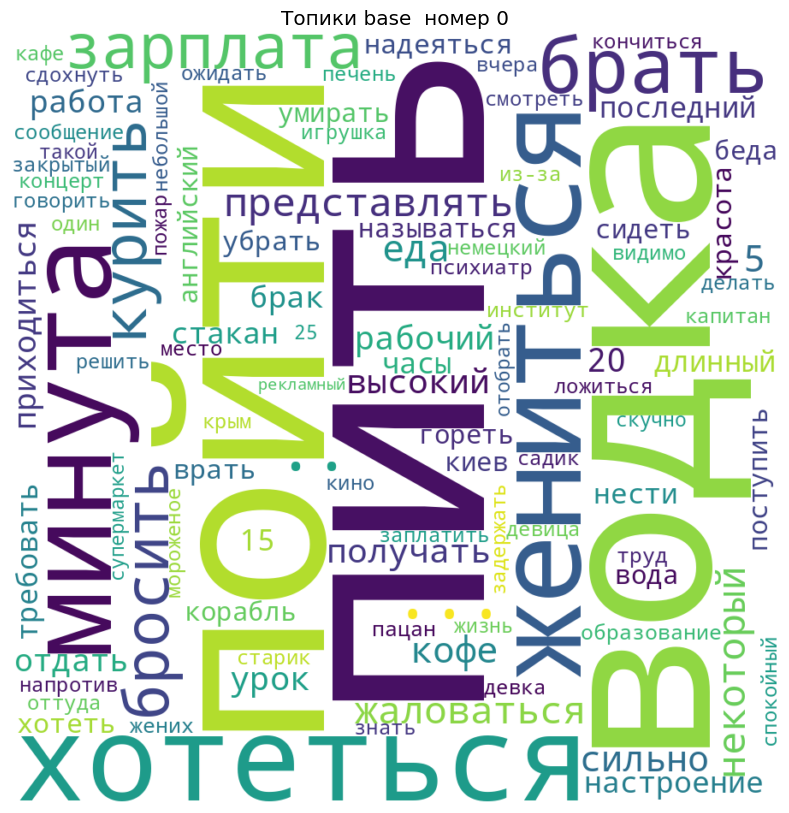

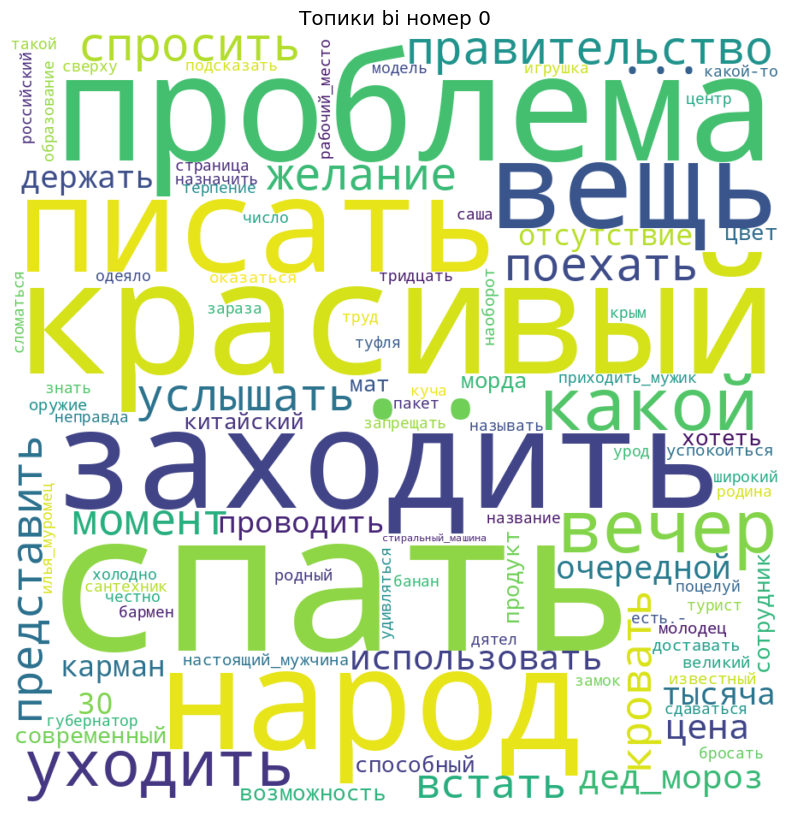

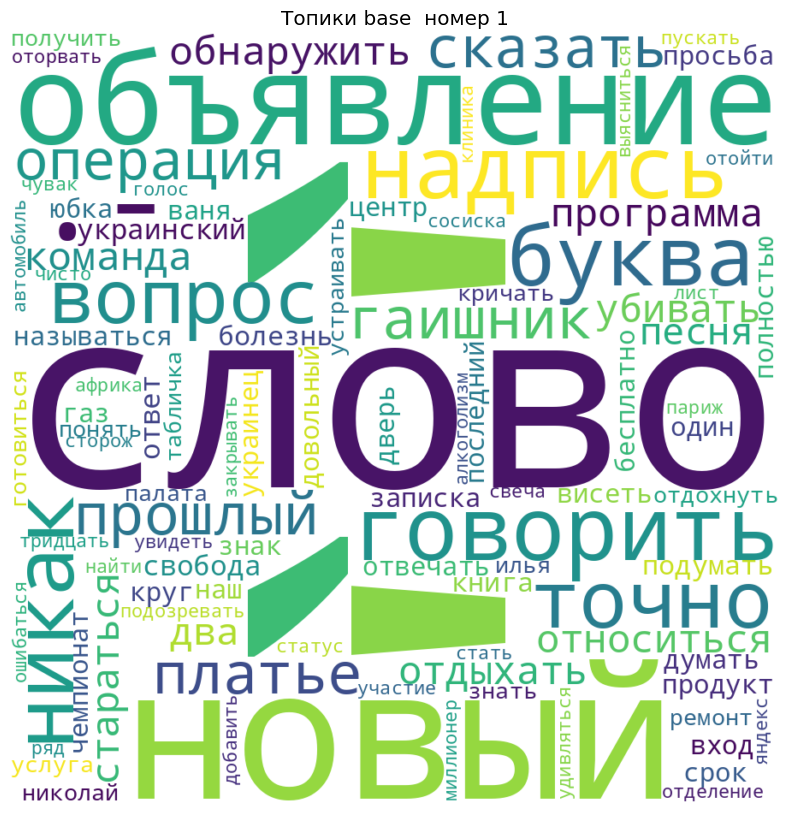

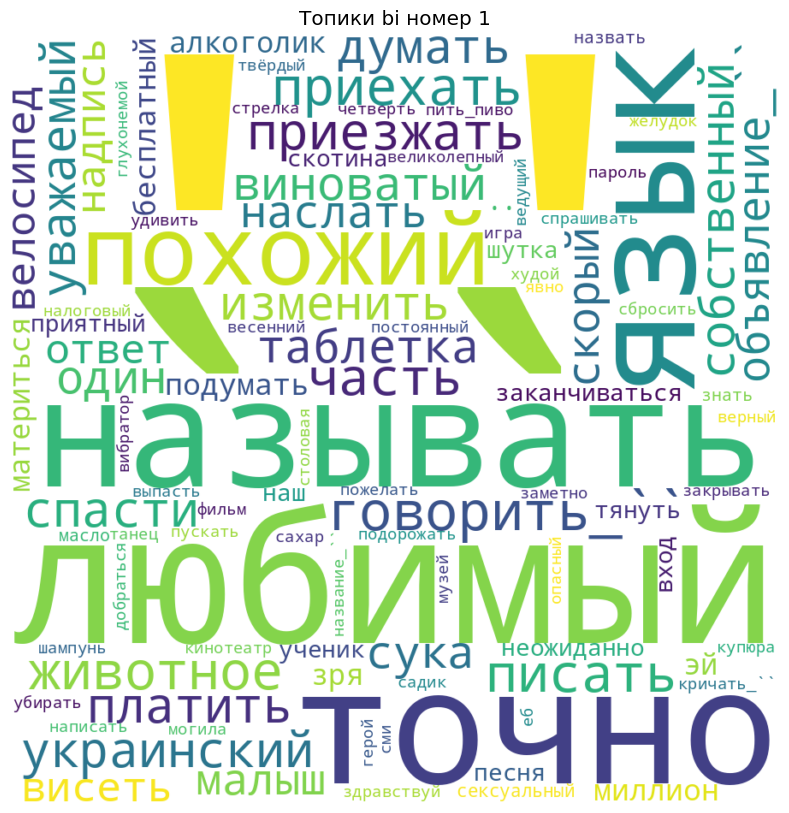

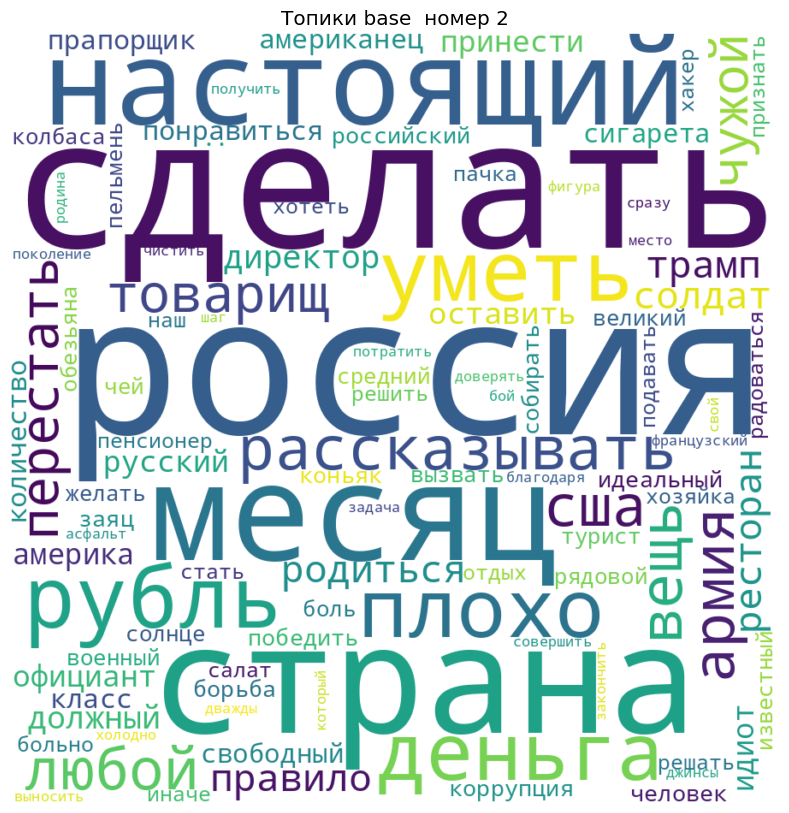

...

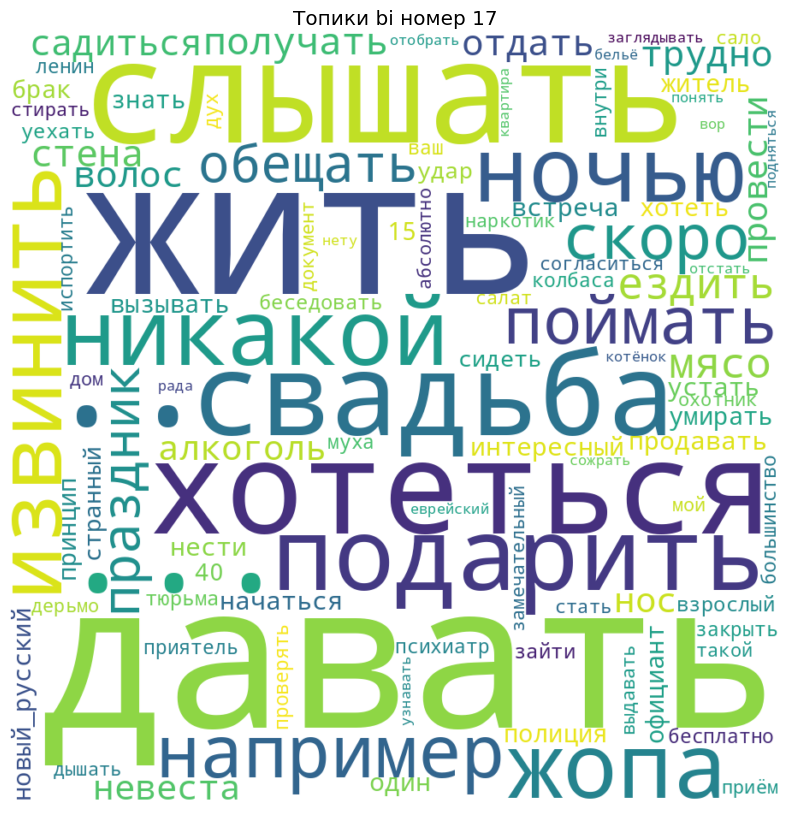

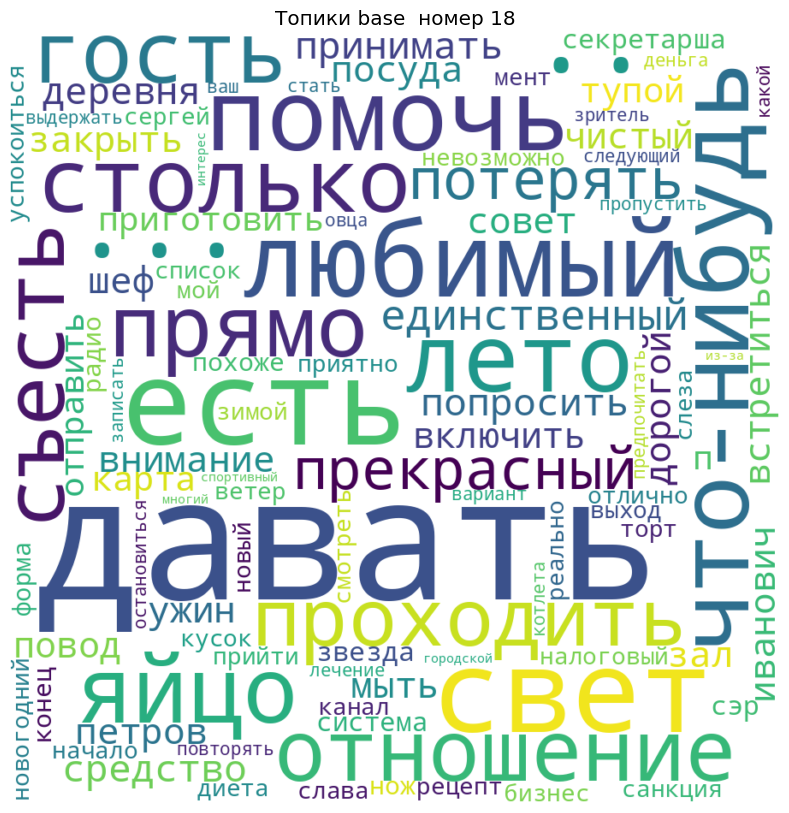

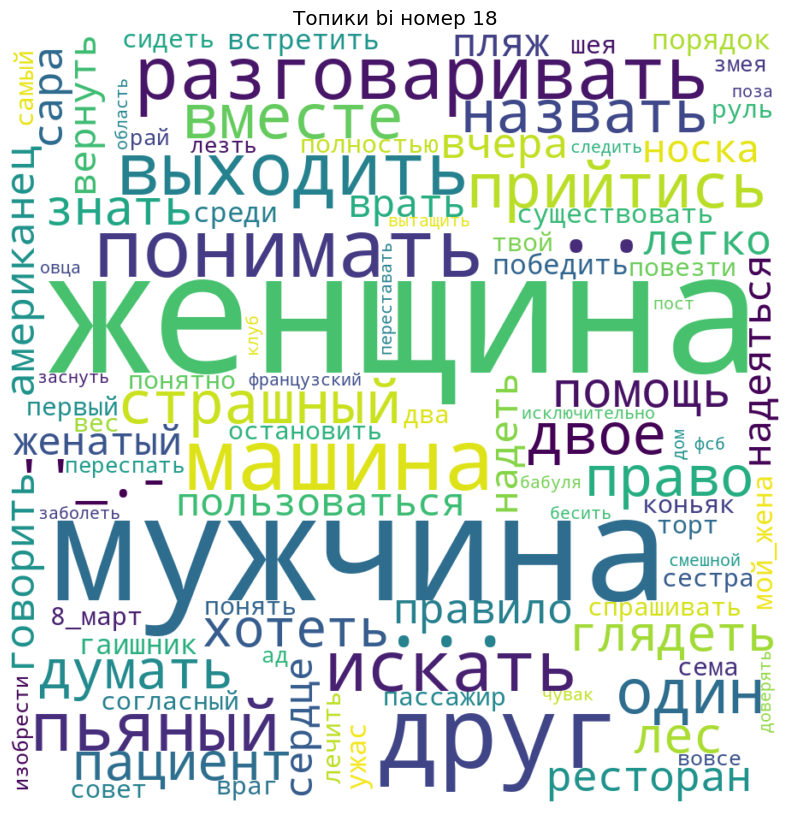

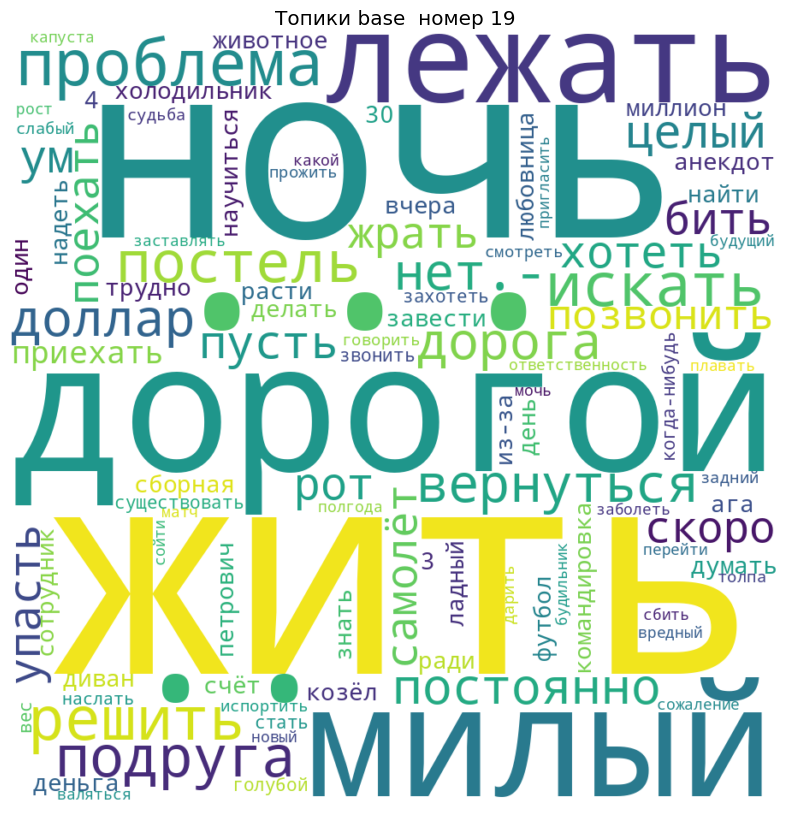

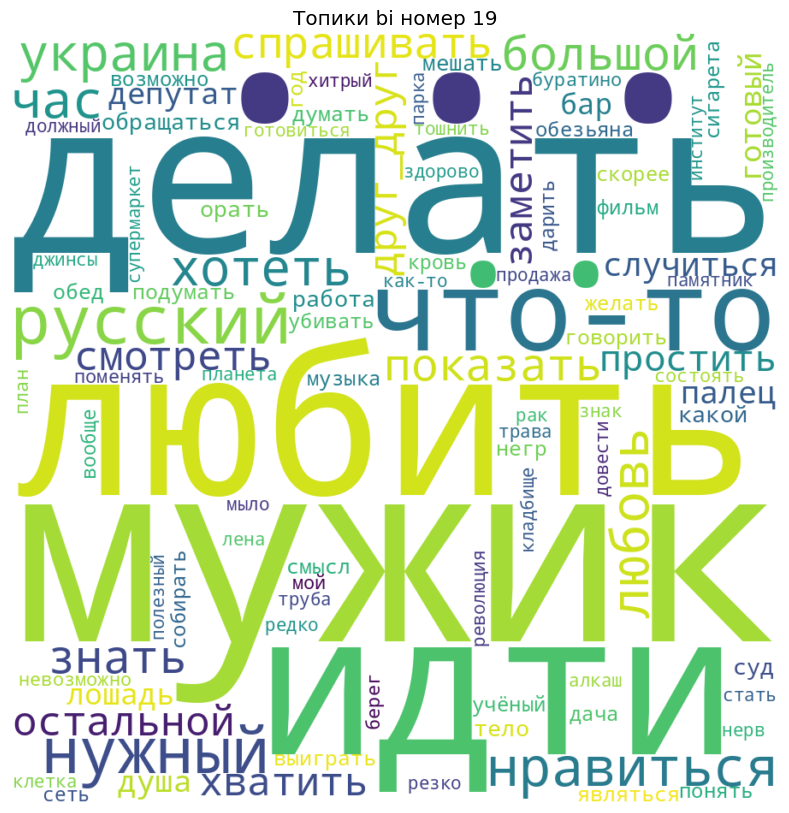

In [ ]:
with open('/content/topics_base_cloud', 'rb') as f:
    lda_topics_base = pickle.load(f)
with open('/content/topics_bi_cloud', 'rb') as f:
    lda_topics_bi = pickle.load(f)
for i in range(20):
  #print(i)
  plotWordCloud(topic_number=i, topics=lda_topics_base,head='Топики base ')
  plotWordCloud(topic_number=i, topics=lda_topics_bi,head='Топики bi')

## Проверим такую идею:

Назначим каждому документу наиболее подходящий (наиболее вероятный) для него топик, для каждой из моделей(base и bi).

In [ ]:
ds_line["lda_base"] = ds_line["text_processed"].apply(get_topic, lda=ldamodel_base)
ds_line["lda_bi"] = ds_line["text_processed"].apply(get_topic, lda=ldamodel_bi)
ds_line["topic_base"] = ds_line["lda_base"].str[0]
ds_line["probability_base"] = ds_line["lda_base"].str[1]
del ds_line["lda_base"]
ds_line["topic_bi"] = ds_line["lda_bi"].str[0]
ds_line["probability_bi"] = ds_line["lda_bi"].str[1]
del ds_line["lda_bi"]
del ds_line["text_processed_new"]
del ds_line["text_processed"]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
ds_line[['topic_base','topic_bi']].head(10)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,topic_base,topic_bi
0,4,17
1,9,4
2,13,1
3,11,3
4,5,7
5,6,0
6,15,18
7,9,18
8,7,2
9,7,5


Сохраним полученные присвоения для дальнейшего использования

In [ ]:
ds_line.to_csv('anekdot_topics.csv',index=False, index_label=False)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Небольшой разведочный анализ полученного результата

In [ ]:
ds_line=pd.read_csv('/content/anekdot_topics.csv')
ds_line.groupby(['topic_base'])['text_base'].count()
ds_line.groupby(['topic_bi'])['text_base'].count()
ds_line

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,text_base,topic_base,probability_base,topic_bi,probability_bi
0,"Сразу после окончания Прямой линии, Путин пожа...",4,0.318902,17,0.287908
1,Это Аркадий. Аркадий попал в армию через посте...,9,0.578500,4,0.578520
2,Толкучка в атобусе. Автобус резко тормозит и ж...,13,0.262450,1,0.253221
3,"Интересно, гадалка уже догадалась, что я еду к...",11,0.578559,3,0.435849
4,"Идет одна бабка, на встречу другой и видит, чт...",5,0.212109,7,0.477250
...,...,...,...,...,...
121646,"Поспорили с женой, кто в доме главный. Она ска...",12,0.175014,12,0.396387
121647,Последним раскрытым громким преступлением в Ки...,0,0.536572,2,0.343676
121648,Если бесконечное количество российских футболи...,2,0.311637,9,0.338954
121649,На чемпионат мира по футболу от России нужно Ю...,7,0.256296,5,0.435732


In [ ]:
ds_line=pd.read_csv('/content/anekdot_topics.csv')
ds_line.groupby(['topic_base'])['text_base'].count()
ds_line.groupby(['topic_bi'])['text_base'].count()
# ds_line.groupby(['topic_nmf'])['text_base'].count()
# ds_line.groupby(['topic_lda'])['text_base'].count()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,text_base
topic_bi,
0,3370
1,10477
2,4832
3,3428
4,4706
5,6050
6,9526
7,4502
8,3172


In [ ]:
ds_line.tail()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,text_base,topic_base,probability_base,topic_bi,probability_bi
121646,"Поспорили с женой, кто в доме главный. Она ска...",12,0.175014,12,0.396387
121647,Последним раскрытым громким преступлением в Ки...,0,0.536572,2,0.343676
121648,Если бесконечное количество российских футболи...,2,0.311637,9,0.338954
121649,На чемпионат мира по футболу от России нужно Ю...,7,0.256296,5,0.435732
121650,В целях профилактики от всего весной следует е...,8,0.150034,18,0.150029


In [ ]:
ds_line.groupby(['topic_base'])['text_base'].count()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,text_base
topic_base,
0,4512
1,10688
2,5252
3,3670
4,5164
5,7978
6,4595
7,4779
8,8453


In [ ]:
ds_line.groupby(['topic_bi'])['text_base'].count()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,text_base
topic_bi,
0,3370
1,10477
2,4832
3,3428
4,4706
5,6050
6,9526
7,4502
8,3172


Оценим степень совпадения топиков полученных по разным исходным данным в библиотеке Gensim.

Определим "устойчивые" - наиболее популярные пары топиков, которые назначаются одному документу.

Поскольку, как мы видим, значение для *probability* в некоторых случаях не высокая, ограничимся только теми записями у которых оно выше **0.5**

In [ ]:
ds_line_lite=ds_line[(ds_line['probability_base']>0.5)&(ds_line['probability_bi']>0.5)]
ds_top=ds_line_lite.groupby(['topic_base','topic_bi'])['text_base'].count().reset_index()
ds_top.columns=['topic_base',	'topic_bi',	'rec_counts']

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
ds_top=ds_line_lite.groupby(['topic_base','topic_bi'])['text_base'].count().reset_index()
ds_top.columns=['topic_base',	'topic_bi',	'rec_counts']
#ds_top.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
ds_top['rec_counts'].describe()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,rec_counts
count,395.000000
mean,15.351899
std,34.753522
min,1.000000
25%,5.000000
50%,9.000000
75%,15.000000
max,559.000000


Видно что разница между минимальным (1) и максимальным значением (181), для более наглядной визуализации полученного результата  воспользуемся функцией десятичного логарифмом от *rec_counts*



In [ ]:
ds_top['log']=np.log10(ds_top['rec_counts'])
topics_base_bi = pd.pivot_table(ds_top,
               index='topic_base',
               values='log',
               columns='topic_bi',
               fill_value=0)
topics_base_bi_np=topics_base_bi.values
#topics_base_bi.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
fig = px.imshow(topics_base_bi,width=600, height=600, labels = dict(y = "Топики Base", x = "Топики Bi", color = "Legend"))
#fig.update_xaxes(side = "top")
fig.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Топики полученных для разных моделей, но имеющие высокую частотность

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



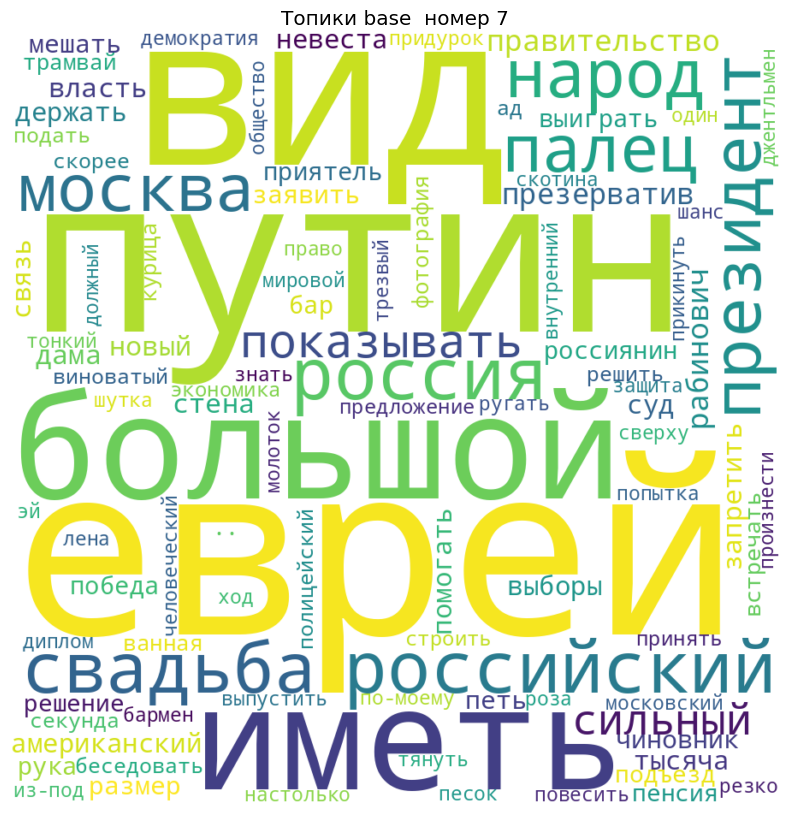

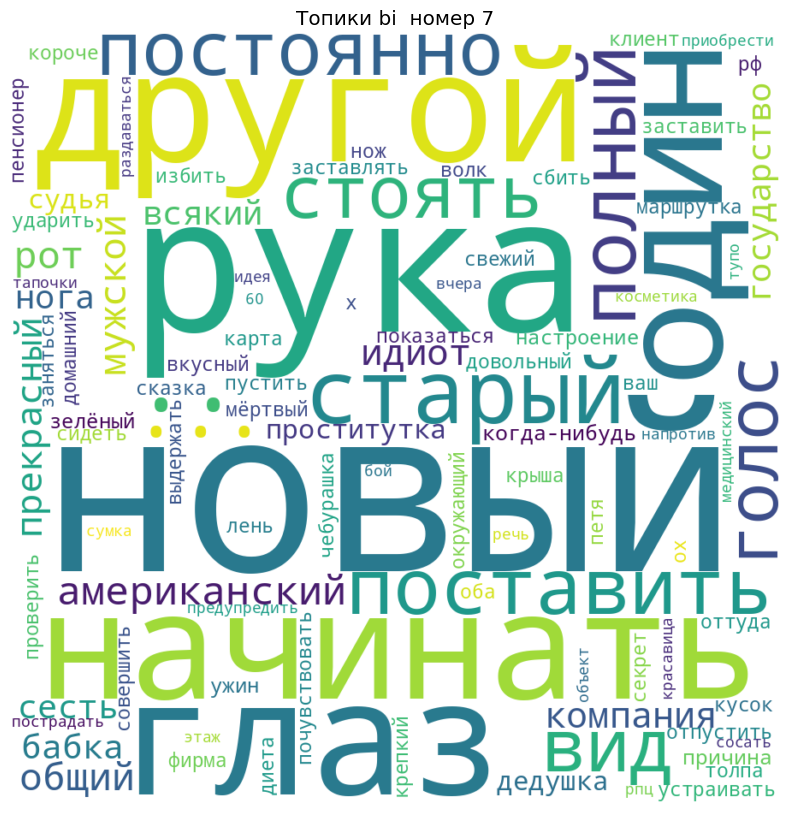

In [ ]:
plotWordCloud(topic_number=7, topics=lda_topics_base,head='Топики base ')
plotWordCloud(topic_number=7, topics=lda_topics_bi,head='Топики bi ')

Как видим они визуально походи и выделяют сходные токены.

Пример сравнения топиков полученных для разных моделей, но имеющие меньшую частоту

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



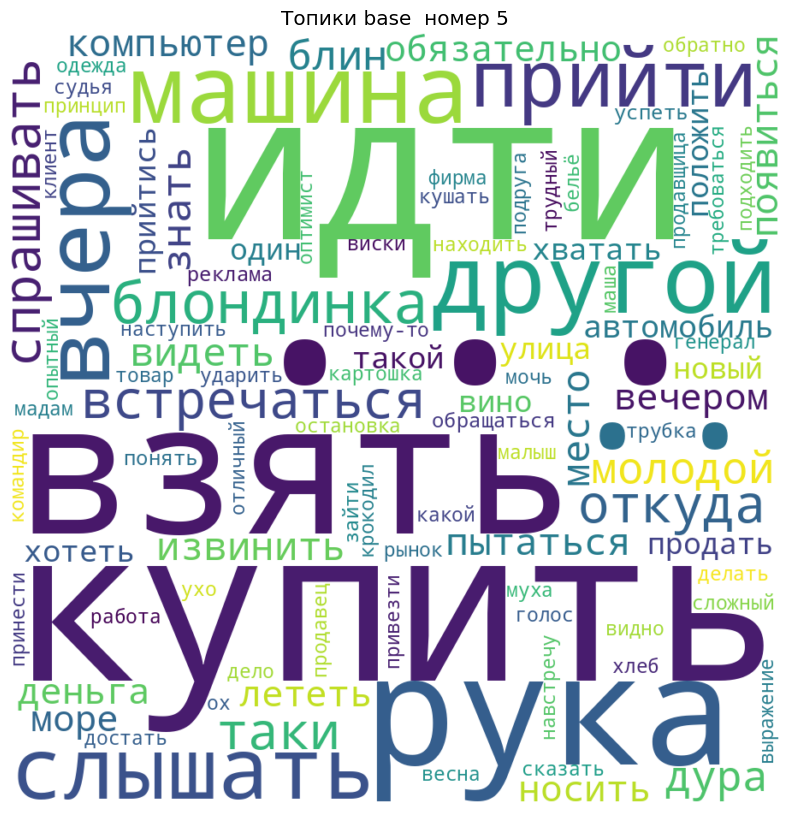

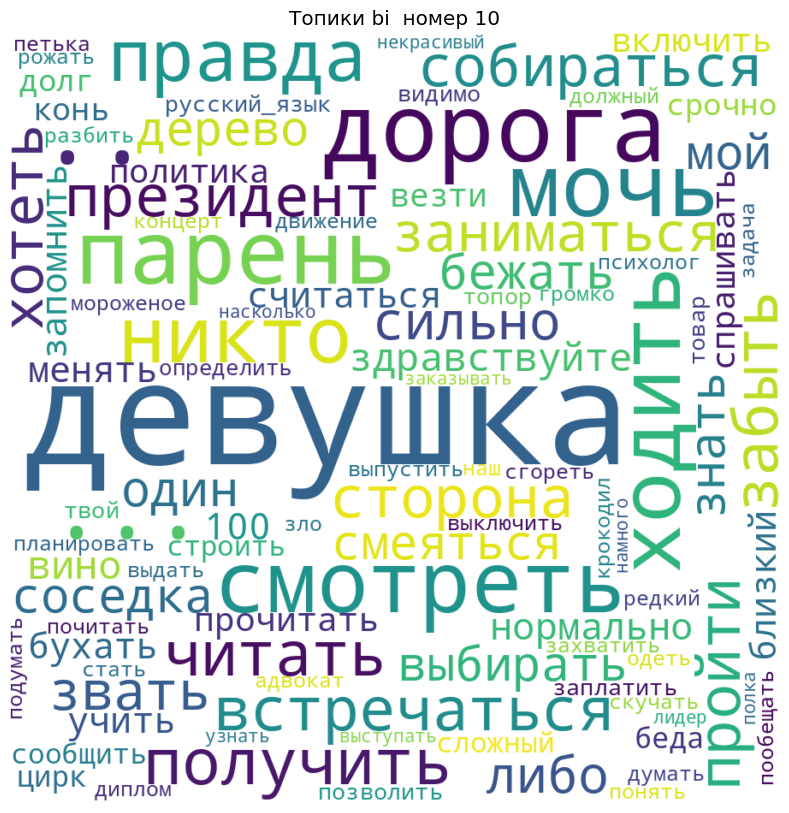

In [ ]:
plotWordCloud(topic_number=5, topics=lda_topics_base,head='Топики base ')
plotWordCloud(topic_number=10, topics=lda_topics_bi,head='Топики bi ')

Видны сходные топики, но их популярность представлена по разному

Топики с низкой частотой

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



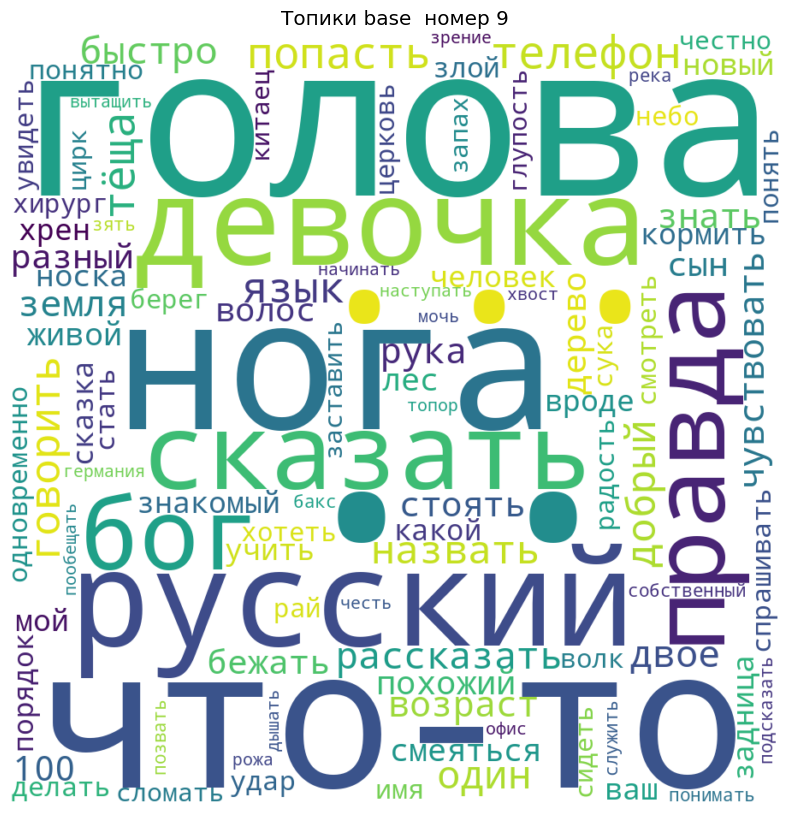

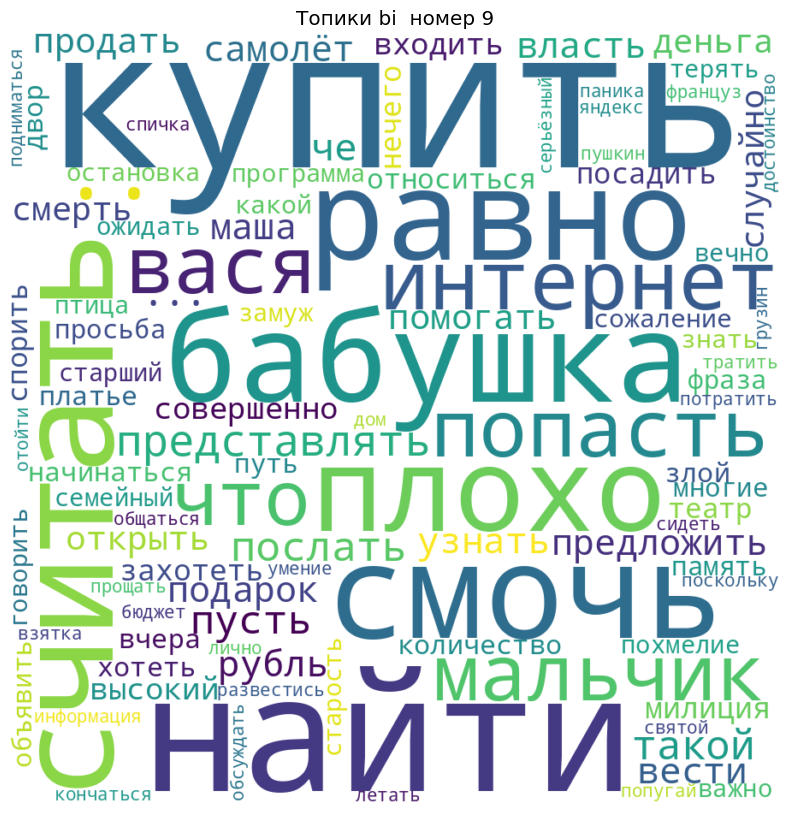

In [ ]:
plotWordCloud(topic_number=9, topics=lda_topics_base,head='Топики base ')
plotWordCloud(topic_number=9, topics=lda_topics_bi,head='Топики bi ')

Видно что между ними практически отсутсвуют общие токены

Другое представление связи между топиками, позволяющее видеть значений логарифма частоты совместной встречаемости

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



<Axes: xlabel='topic_bi', ylabel='topic_base'>

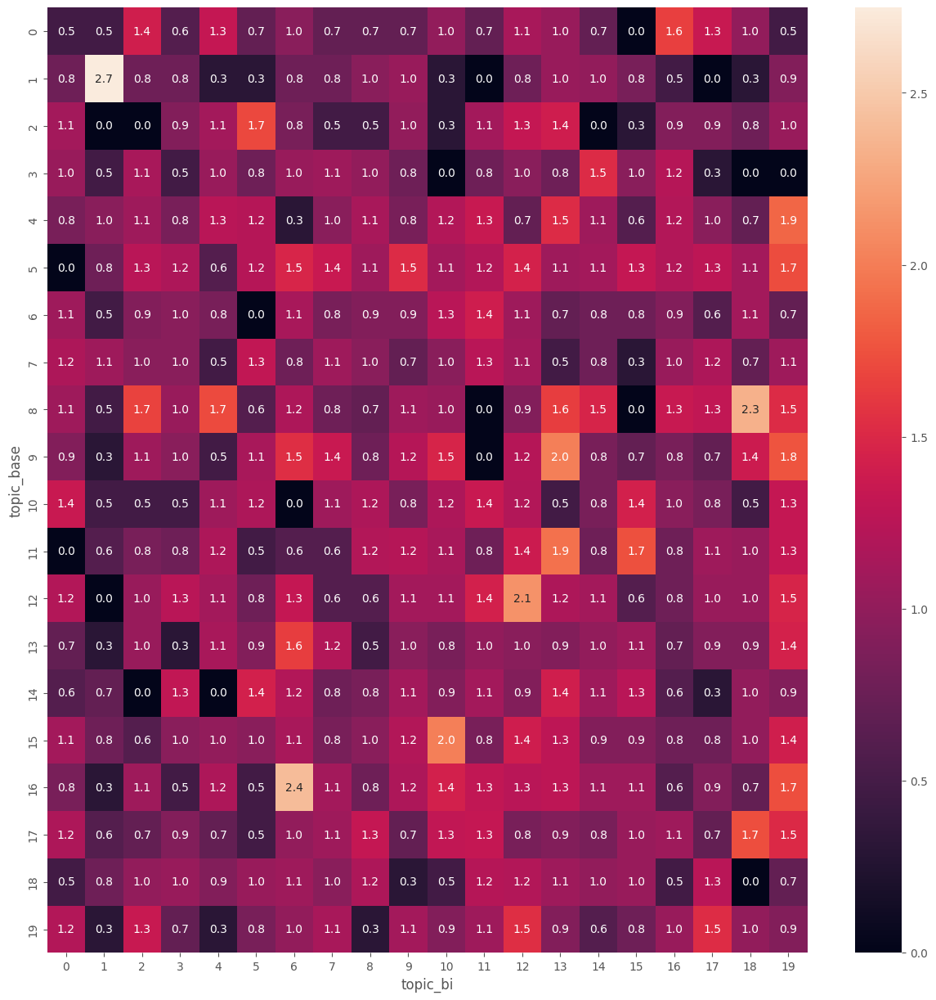

In [ ]:
plt.rcParams['figure.figsize']=15,15
sns.heatmap(topics_base_bi, annot=True, fmt=".1f")

Следует отметить, что полученные выше результат относится лишь к 3% от общего числа документов (9*394=3546).

Снижение порога до уровня 0.4 или 0.3 - увеличило бы число учитываемых документов, но снижало бы достоверность отнесения документов к одному топику.

# В библиотеке **sklearn** для векторизации на базе весов TF-IDF для токенов в предложениях текста, воспользуемся функцией Tfidfvectorizer.

Модель Tfidfvectorizerсоздает представление исходного массива текстов разреженой матрицей размерности (N - количество тектов, M - мощность словаря), при этом словарь фильтруется отсекая токены имеющие малые значения величины (веса) TF-IDF.

Импротируем созраненные данные, при этом пропустим этап токенизации и лемматизации воспользовавшись текстами подготовленными при работе с Gensim

In [ ]:
nltk_download("punkt")
!wget https://raw.githubusercontent.com/dhhse/dh2020/master/data/stop_ru.txt
with open ("stop_ru.txt", "r") as stop_ru:
    rus_stops = [word.strip() for word in stop_ru.readlines()]
punctuation = '!\"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~—»«...–'
filter_token = rus_stops + list (punctuation)
filter=filter_token

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.

<>:5: DeprecationWarning:

invalid escape sequence '\]'

<>:5: DeprecationWarning:

invalid escape sequence '\]'

<ipython-input-151-9f132f2f2ac1>:5: DeprecationWarning:

invalid escape sequence '\]'

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


--2024-11-29 15:59:20--  https://raw.githubusercontent.com/dhhse/dh2020/master/data/stop_ru.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5823 (5.7K) [text/plain]
Saving to: ‘stop_ru.txt.2’

stop_ru.txt.2       100%[===================>]   5.69K  --.-KB/s    in 0s      

2024-11-29 15:59:20 (40.2 MB/s) - ‘stop_ru.txt.2’ saved [5823/5823]



In [ ]:
ds_line = pd.read_csv('anekdot_pr.csv') #,converters={"text_processed": literal_eval})
from sklearn.feature_extraction.text import TfidfVectorizer
#no_features = 300

#tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2, max_features=no_features, stop_words=filter)
tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2,  stop_words=filter)
tfidf = tfidf_vectorizer.fit_transform(ds_line["text_processed_new"].values.astype('U'))

tokens_sklearn = tfidf_vectorizer.get_feature_names_out()
print('Длина словаря',len(tokens_sklearn))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Длина словаря 33108


Модель TfidfVectorizer позволяет создавать словари с заранее ограниченной длинной и без такого ограничения. Для нашего исследования ограничение снято.

Полученная мощность словаря сопоставима с той, что была полученно для мешка слов в Gensim

In [ ]:
tokens_sklearn

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



array(['00', '01', '02', ..., 'ёрш', 'ёршик', 'ёсик'], dtype=object)

## Модели получения тем

In [ ]:
from sklearn.decomposition import NMF, LatentDirichletAllocation
no_topics = 20
no_top_words=10

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



### тренировка моделей получения числа топиков, для двух подходов выделения топиков.

In [ ]:
# Model lda_tfidf
lda_tfidf = LatentDirichletAllocation(n_components=no_topics, max_iter=5, learning_method='online', learning_offset=50.,random_state=1024).fit(tfidf)
# Model NMF
nmf = NMF(n_components=no_topics, random_state=1024, l1_ratio=.5, init='nndsvd').fit(tfidf)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1759: ConvergenceWarning:

Maximum number of iterations 200 reached. Increase it to improve convergence.



### получим распределение топиков для текстов и произведем присвоение полученных значений текстам наиболее популярных топиков, аналогично тому как это было сделано для моделей в Gensim

In [ ]:
top_lda=topics_max(tfidf,lda_tfidf)
top_nmf=topics_max(tfidf,nmf)
ds_topic=pd.read_csv('/content/anekdot_topics.csv')
ds_topic['topic_nmf']=top_nmf[:,1]
ds_topic['probability_nmf']=top_nmf[:,0]
ds_topic['topic_lda']=top_lda[:,1]
ds_topic['probability_lda']=top_lda[:,0]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
top_nmf=topics_max(tfidf,nmf)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
ds_topic=pd.read_csv('/content/anekdot_topics.csv')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
ds_topic['topic_nmf']=top_nmf[:,1]
ds_topic['probability_nmf']=top_nmf[:,0]

ds_topic['topic_lda']=top_lda[:,1]
ds_topic['probability_lda']=top_lda[:,0]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
ds_topic.head(50)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



,text_base,topic_base,probability_base,topic_bi,probability_bi,topic_nmf,probability_nmf,topic_lda,probability_lda
0,"Сразу после окончания Прямой линии, Путин пожа...",4,0.318902,17,0.287908,6.0,0.005586,13.0,0.690464
1,Это Аркадий. Аркадий попал в армию через посте...,9,0.578500,4,0.578520,19.0,0.002754,17.0,0.679510
2,Толкучка в атобусе. Автобус резко тормозит и ж...,13,0.262450,1,0.253221,1.0,0.034489,10.0,0.626270
3,"Интересно, гадалка уже догадалась, что я еду к...",11,0.578559,3,0.435849,19.0,0.004937,5.0,0.572086
4,"Идет одна бабка, на встречу другой и видит, чт...",5,0.212109,7,0.477250,4.0,0.041051,14.0,0.711752
5,Журналист берет интервью у долгожительницы:- К...,6,0.519894,0,0.465341,15.0,0.099443,1.0,0.666844
6,- Ты восхитительная. Потрясающая. Умная. Сексу...,15,0.236321,18,0.271528,1.0,0.079468,14.0,0.635491
7,Волк 3 раза обедал в эстонском капкане,9,0.578519,18,0.435616,16.0,0.002747,19.0,0.682323
8,Женщины смотрят фотографии:- А что это ты тут ...,7,0.440618,2,0.565706,1.0,0.034383,2.0,0.550662
9,Почему Путин не выделил пять тысяч на содержан...,7,0.210057,5,0.210042,6.0,0.005025,6.0,0.247883


Сохраним для дальнейшего анализа файл содержащий ссылки на топики к которым отнесены анекдоты разными моделями.

In [ ]:
ds_topic.to_csv('anekdot_topics.csv',index=False, index_label=False)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



### Визуализация топиков полученный по моделям nmf и lda_tf-idf

In [ ]:
no_top_words=10
topic_lda=display_topics(lda_tfidf, tokens_sklearn, no_top_words)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Topic 0:
['жена', 'девушка', 'муж', 'женщина', 'смотреть', 'сосед', 'женский', 'секс', 'мужик', 'мужчина']
Topic 1:
['конец', 'брать', 'свет', 'возраст', 'быстрый', 'перестать', 'смысл', 'люся', 'земля', 'рабочий']
Topic 2:
['разница', 'нечего', 'суп', 'милиция', 'отдыхать', 'зима', 'сила', 'китайский', 'изменить', 'упасть']
Topic 3:
['звать', 'счастливый', 'мир', 'мороз', 'дед', 'брак', 'цвет', 'красный', 'спина', 'фамилия']
Topic 4:
['россия', 'деньга', 'хороший', 'страна', 'плохой', 'президент', 'знать', 'плохо', 'новый', 'путин']
Topic 5:
['ошибка', 'бывать', 'учёный', 'студент', 'доказать', 'бухать', 'номер', 'чиновник', 'курс', 'жаль']
Topic 6:
['страшный', 'мечтать', 'мешать', 'написать', 'буква', 'настроение', 'чувство', 'враг', 'пенсия', 'компания']
Topic 7:
['пиво', 'пить', 'чай', 'правильно', 'уходить', 'женатый', 'вода', 'праздник', 'разный', 'животное']
Topic 8:
['доктор', 'замуж', 'выйти', 'выходить', 'блондинка', 'ум', 'дура', 'врач', 'гость', 'правило']
Topic 9:
['нога'

In [ ]:
topic_nmf=display_topics(nmf, tokens_sklearn, no_top_words)

Topic 0:
['мама', 'папа', 'сынок', 'сын', 'вовочка', 'отец', 'мальчик', 'маленький', 'девочка', 'спрашивать']
Topic 1:
['женщина', 'красивый', 'умный', 'секс', 'сделать', 'понимать', 'возраст', 'понять', 'резиновый', 'молодой']
Topic 2:
['жена', 'муж', 'домой', 'дорогой', 'дорога', 'дом', 'постель', 'любовница', 'изменять', 'любовник']
Topic 3:
['девушка', 'парень', 'красивый', 'молодой', 'познакомиться', 'давать', 'секс', 'замуж', 'нравиться', 'умный']
Topic 4:
['знать', 'откуда', 'точно', 'никто', 'слово', 'язык', 'вообще', 'находиться', 'ой', 'работать']
Topic 5:
['любить', 'никто', 'ненавидеть', 'любовь', 'милый', 'спать', 'кошка', 'дорога', 'водка', 'ухо']
Topic 6:
['россия', 'самый', 'страна', 'путин', 'стать', 'президент', 'дорога', 'украина', 'мир', 'сша']
Topic 7:
['друг', 'враг', 'собака', 'настоящий', 'подруга', 'понимать', 'встречаться', 'свадьба', 'давать', 'страшный']
Topic 8:
['хороший', 'плохой', 'самый', 'новость', 'секс', 'сделать', 'настроение', 'способ', 'найти', 'с

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
topic_nmf.to_csv('topic_nmf.csv',index=False, index_label=False)
topic_lda.to_csv('topic_lda.csv',index=False, index_label=False)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Облака для топиков моделей sklearn

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



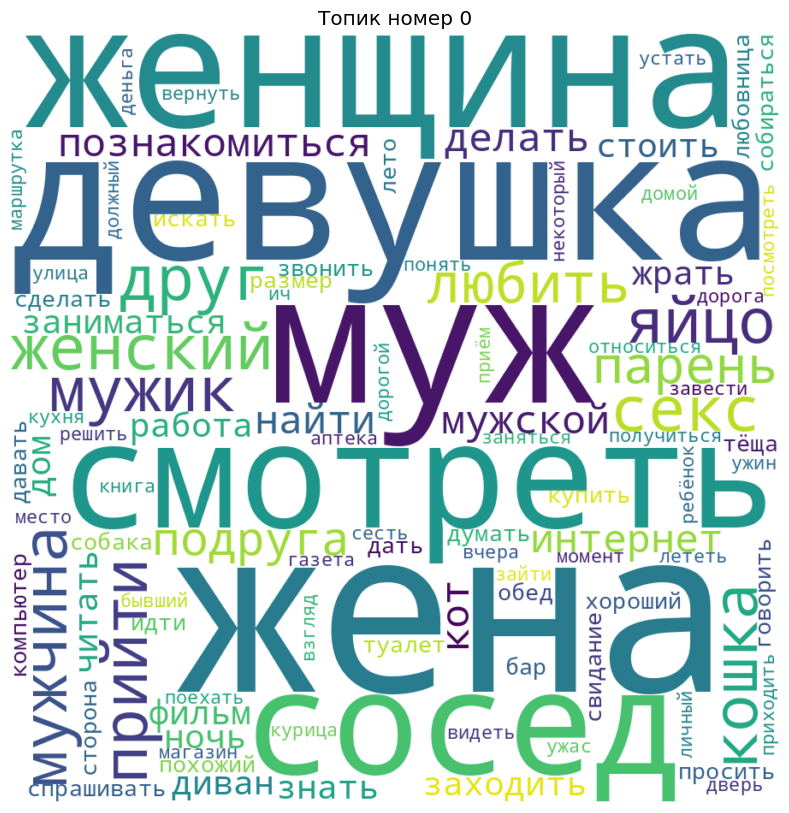

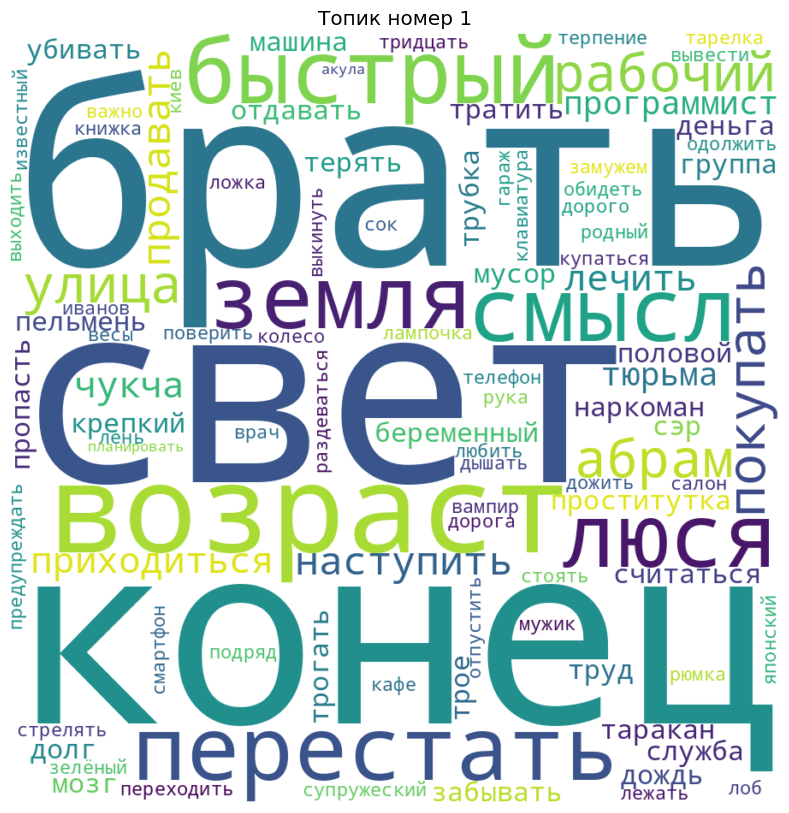

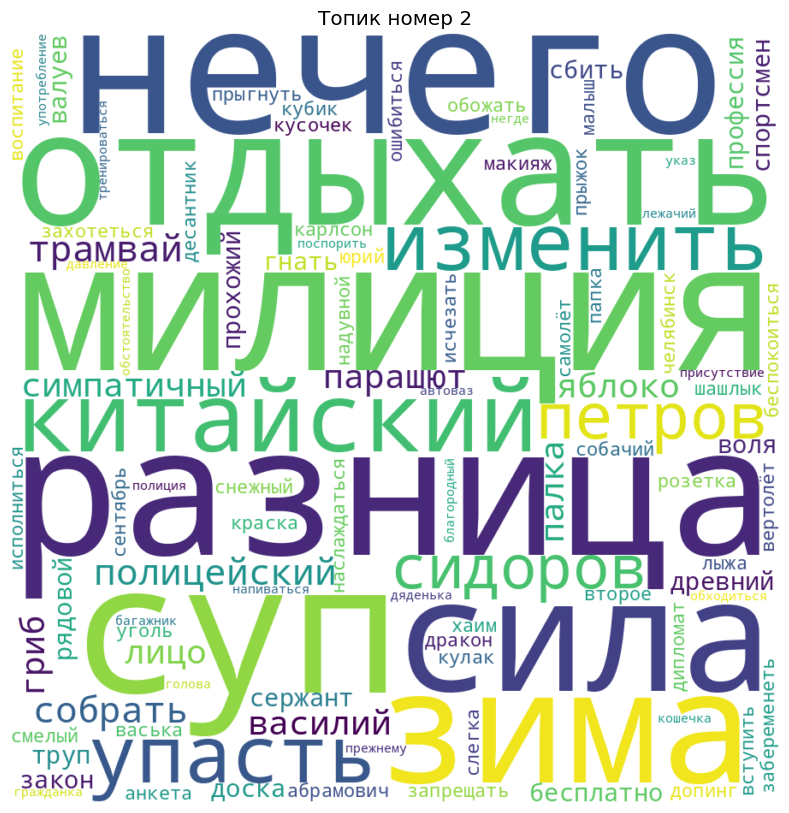

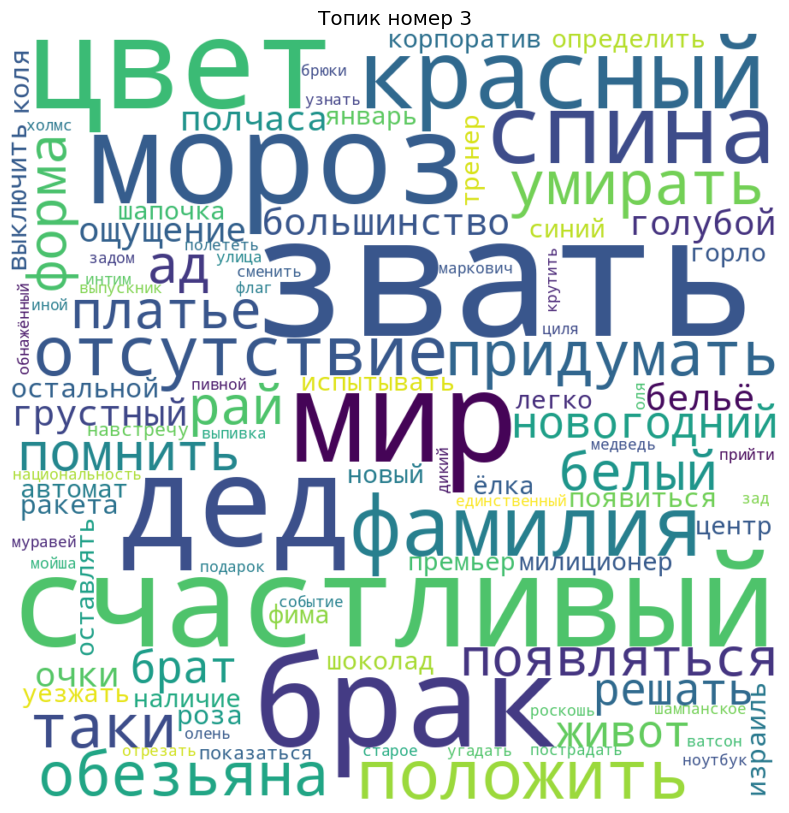

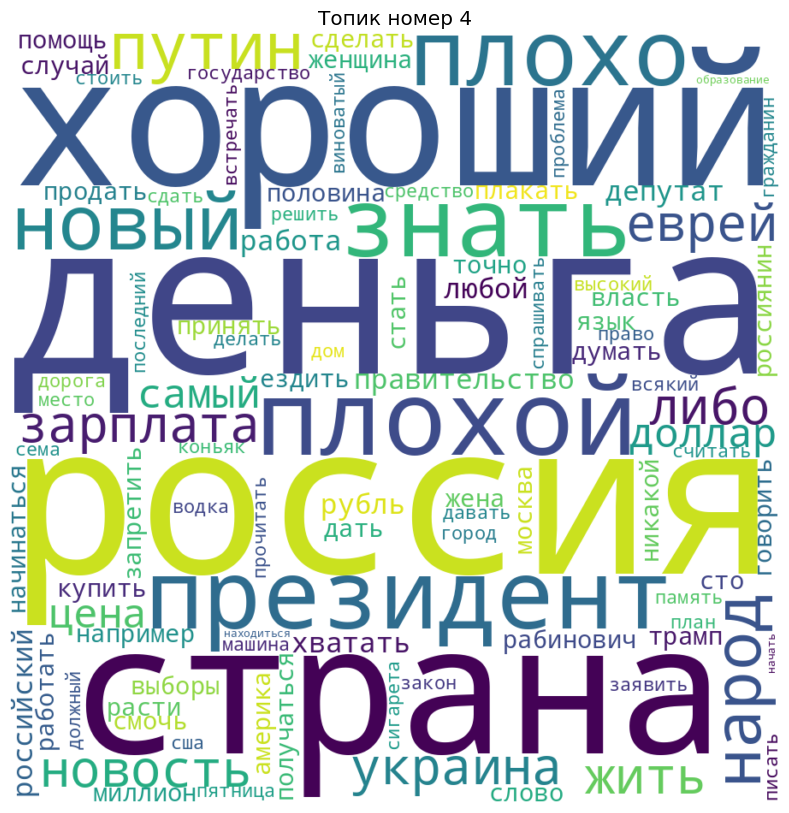

...

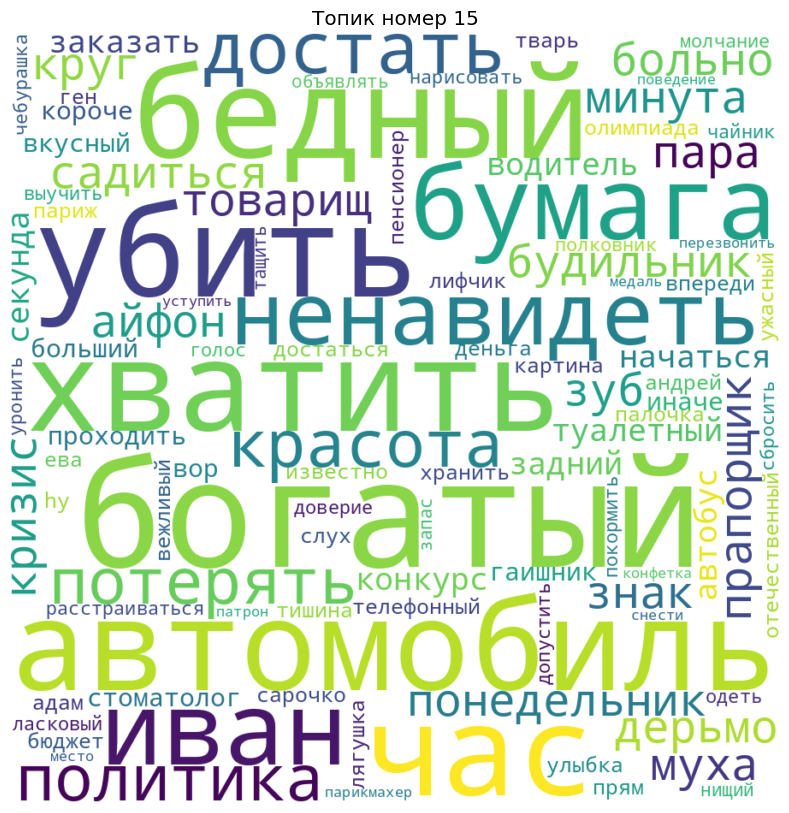

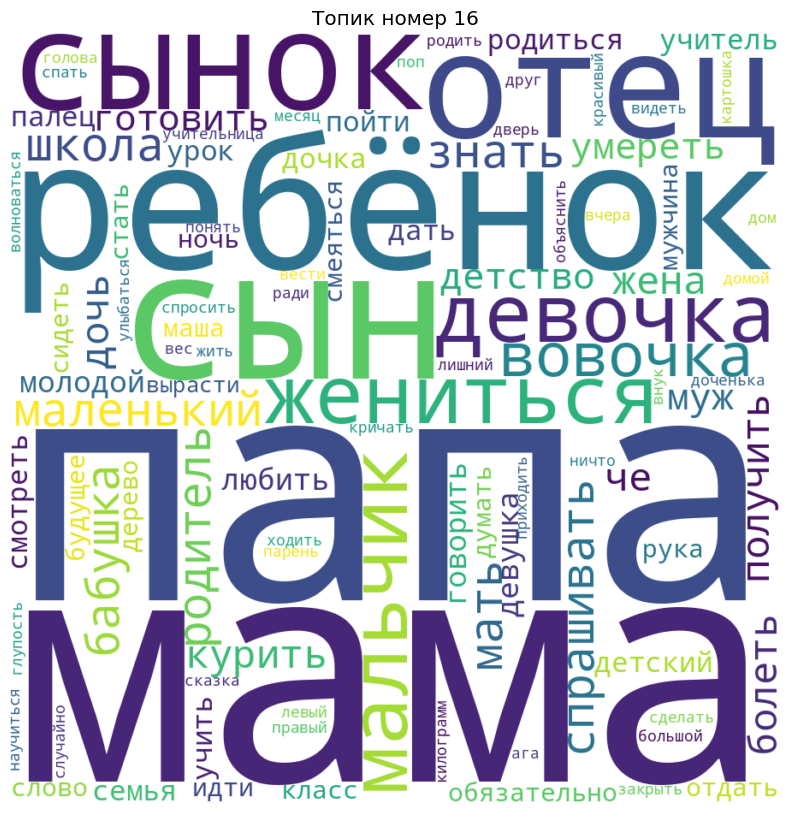

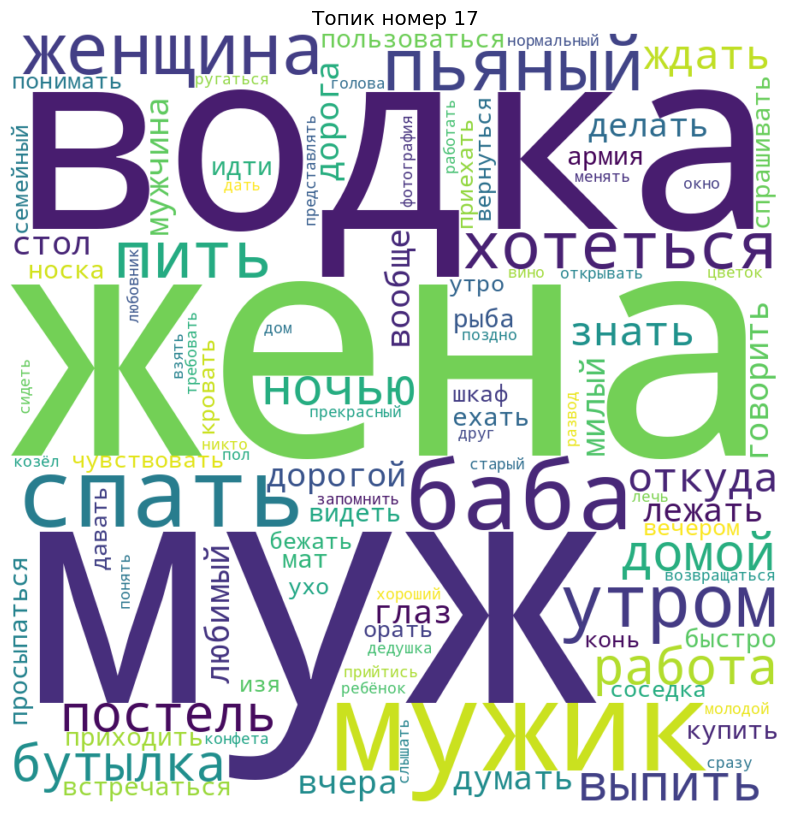

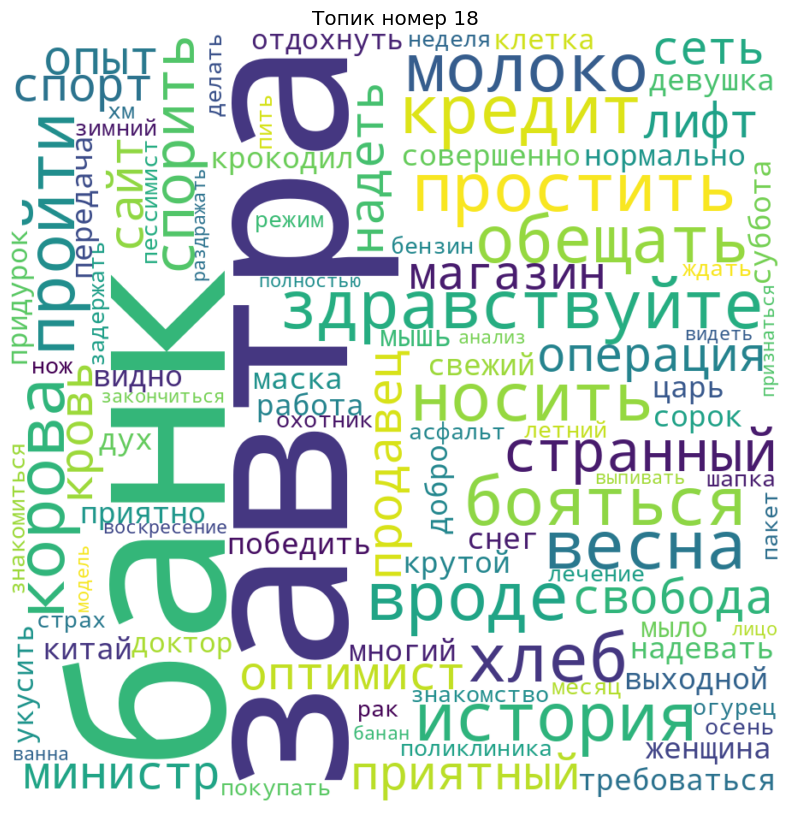

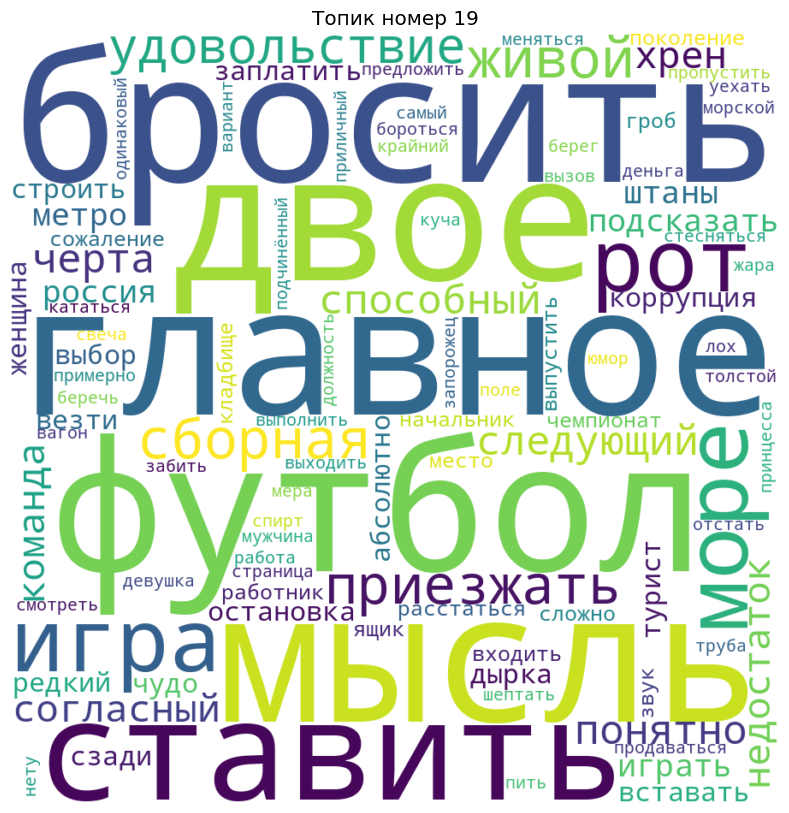

In [ ]:
for i in range(20):
    plotWordCloud_2(topic_number=i, topics=topic_lda)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



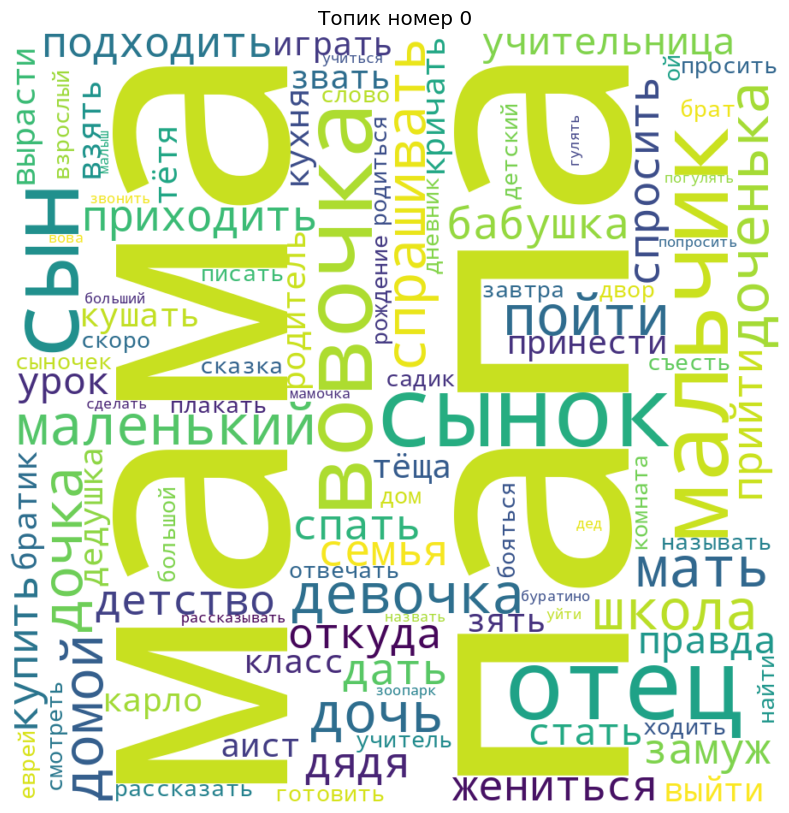

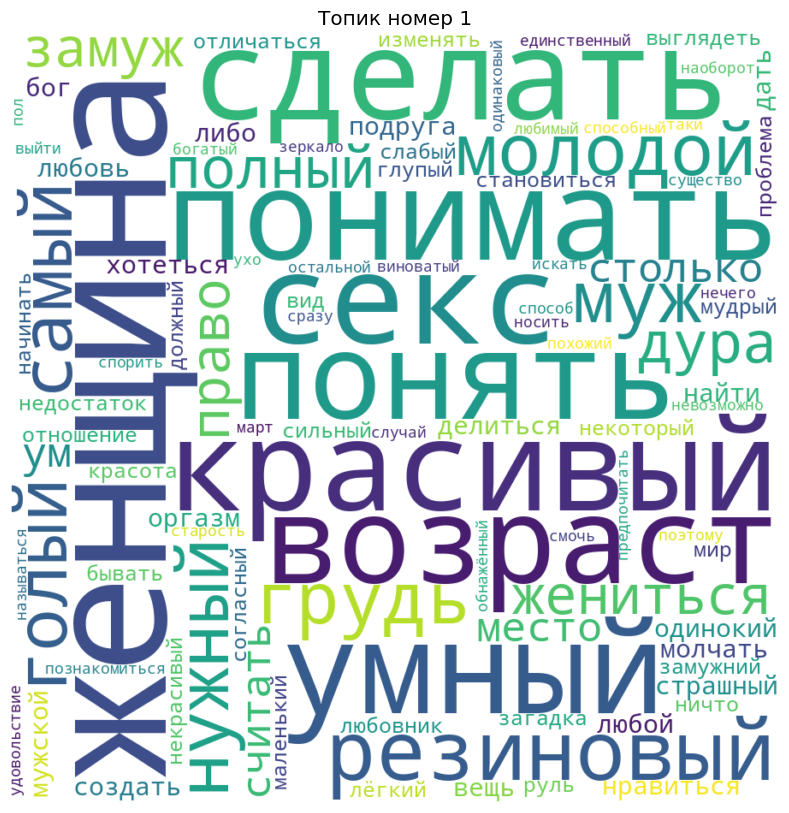

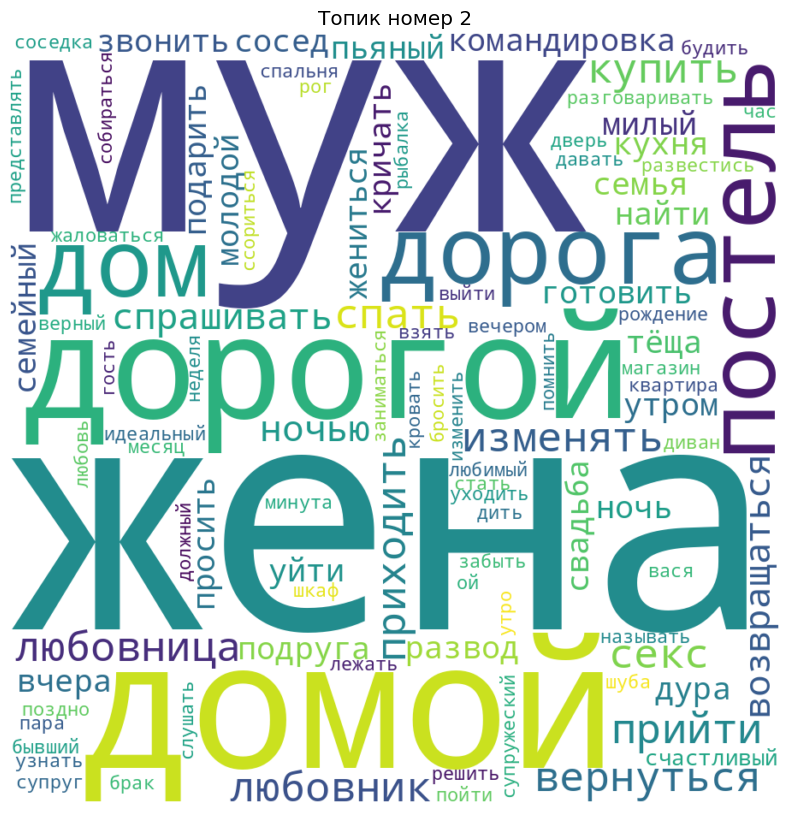

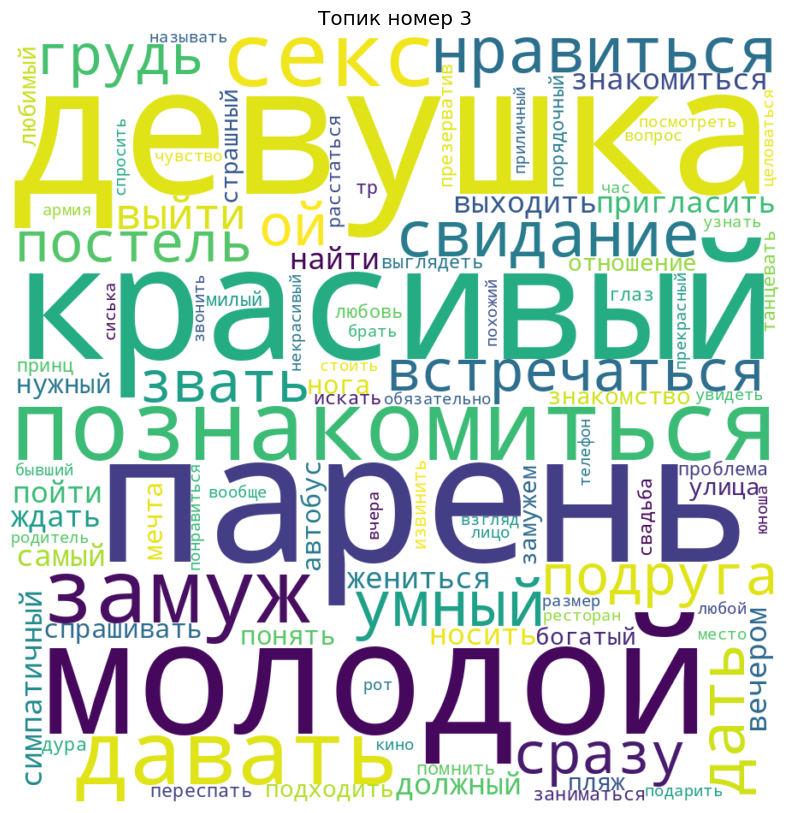

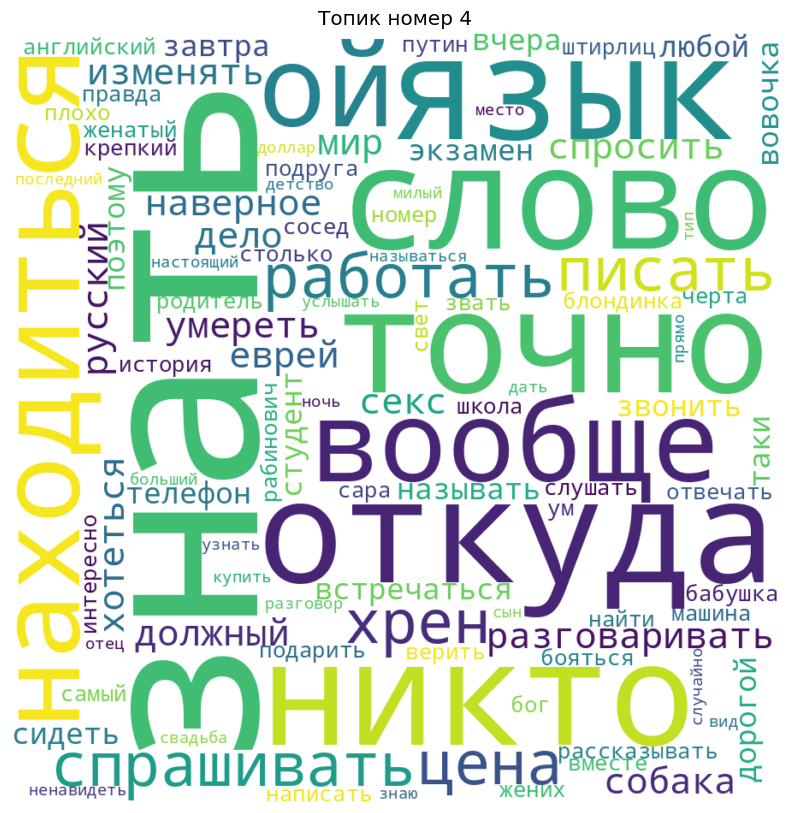

...

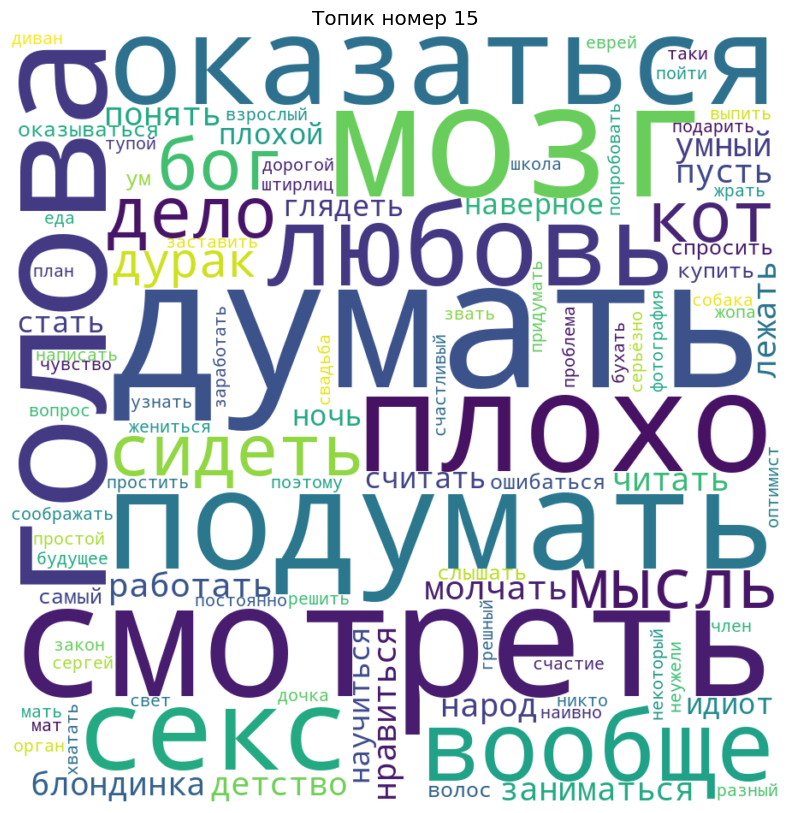

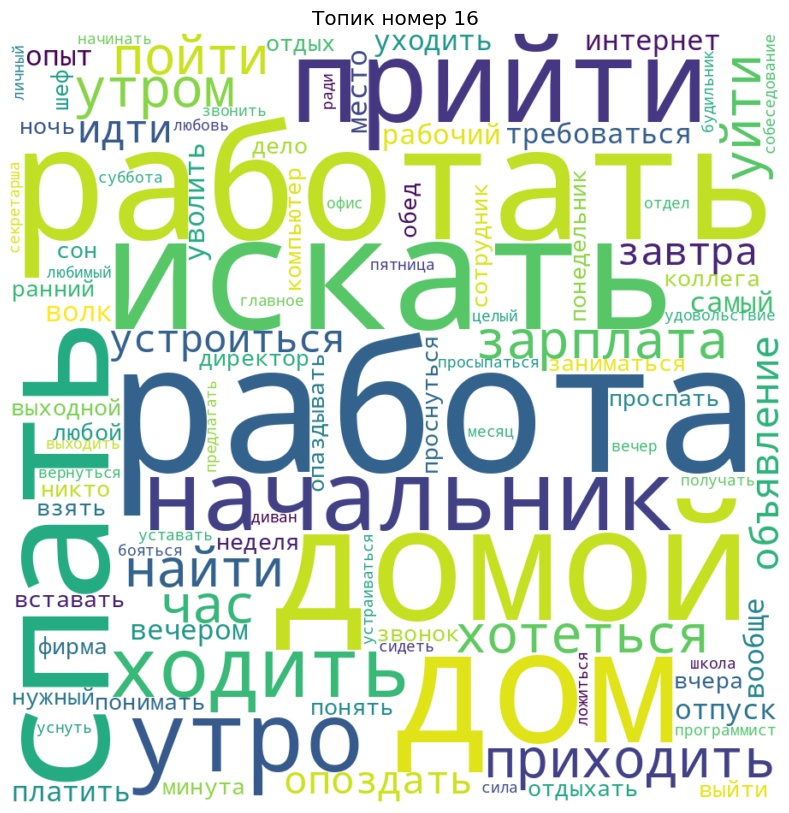

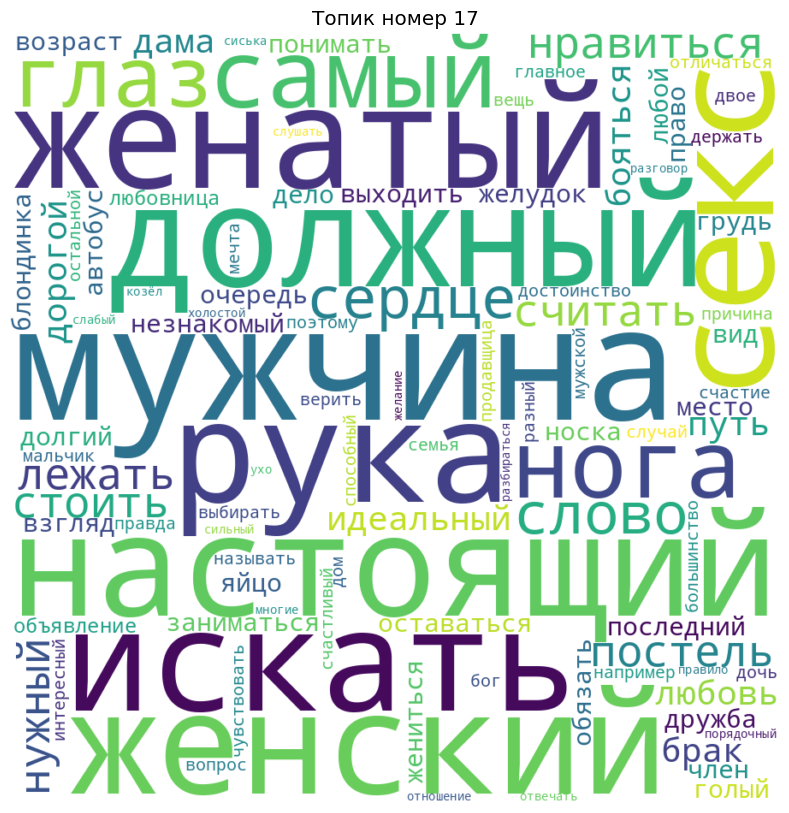

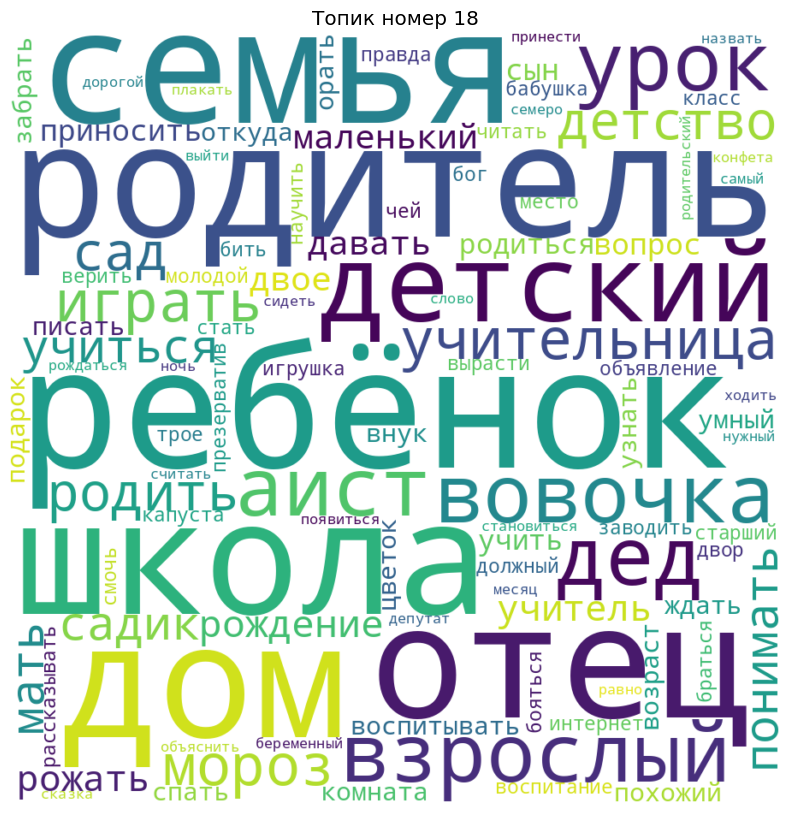

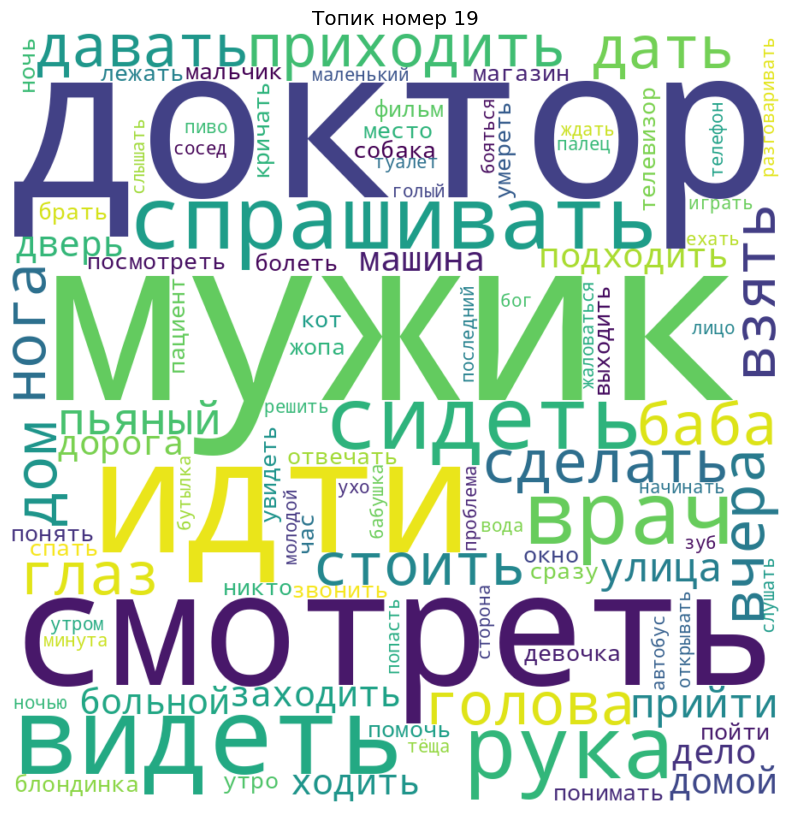

In [ ]:
for i in range(20):
    plotWordCloud_2(topic_number=i, topics=topic_nmf)

## По аналогии с предыдущим случаем, интересно сравнить топики формируемые разными подходами и особенностями библиотек gensim и sklearn.

Импортируем сохраненные ранее сохраненые топики

In [ ]:
topic_base=pd.read_csv('/content/topic_base.csv')
topic_bi=pd.read_csv('/content/topic_bi.csv')
topic_nmf=pd.read_csv('/content/topic_nmf.csv')
topic_lda=pd.read_csv('/content/topic_lda.csv')
#topic_gemsim_np=topic_gemsim.values
#topic_nmf_np=topic_nmf.values


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



### для получения эмбеддингов используем модель "маленький BERT" описанную в  https://habr.com/ru/post/562064/ .

Из нее получим модели токенизации получения эбеддингов

In [ ]:
import torch
from transformers import AutoTokenizer, AutoModel
tokenizer = AutoTokenizer.from_pretrained("cointegrated/rubert-tiny")
model = AutoModel.from_pretrained("cointegrated/rubert-tiny")
# model.cuda()  # uncomment it if you have a GPU

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning:


The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.



tokenizer_config.json:   0%|          | 0.00/341 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/632 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/241k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/468k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/tensorflow/lite/python/util.py:55: DeprecationWarning:

jax.xla_computation is deprecated. Please use the AOT APIs; see https://jax.readthedocs.io/en/latest/aot.html. For example, replace xla_computation(f)(*xs) with jit(f).lower(*xs).compiler_ir('hlo'). See CHANGELOG.md for 0.4.30 for more examples.

/usr/local/lib/python3.10/dist-packages/tensorflow/lite/python/util.py:55: DeprecationWarning:

jax.xla_computation is deprecated. Please use the AOT APIs; see https://jax.readthedocs.io/en/latest/aot.html. For example, replace xla_computation(f)(*xs) with jit(f).lower(*xs).compiler_ir('hlo'). See CHANGELOG.md for 0.4.30 for more examples.



model.safetensors:   0%|          | 0.00/47.7M [00:00<?, ?B/s]

## Для примера сравним топики из моделей topic_base (Gensim) и topic_nmf (Sklearn).

И ограничимся 15 первыми словами каждого из топиков (иначе ресурсов бесплатного colab может не хватить).

Сравнение векторов полученных из эмбеддингов, осуществим на основании косинусного расстояния.

In [ ]:
print(topic_base.columns)  # Вывод всех колонок DataFrame


Index(['topic', 'word_in topic', 'weght_topic'], dtype='object')


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
print(topic_base)  # Вывод всех колонок DataFrame


      topic word_in topic  weght_topic
0         0          пить     0.049141
1         0         пойти     0.029610
2         0         водка     0.028038
3         0      хотеться     0.021890
4         0      жениться     0.021810
...     ...           ...          ...
1995     19       перейти     0.002779
1996     19          матч     0.002724
1997     19       будущий     0.002721
1998     19       вредный     0.002714
1999     19    пригласить     0.002699

[2000 rows x 3 columns]


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
print(topic_nmf)  # Вывод всех колонок DataFrame


       topic   topic_word  topic_val
0          0         мама   6.855068
1          0         папа   5.233208
2          0        сынок   1.826546
3          0          сын   1.417577
4          0      вовочка   1.268411
...      ...          ...        ...
19995     19    прикинуть   0.016322
19996     19      мёртвый   0.016314
19997     19  понедельник   0.016304
19998     19         рожа   0.016298
19999     19         лапа   0.016297

[20000 rows x 3 columns]


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



<Axes: xlabel='nmf', ylabel='base'>

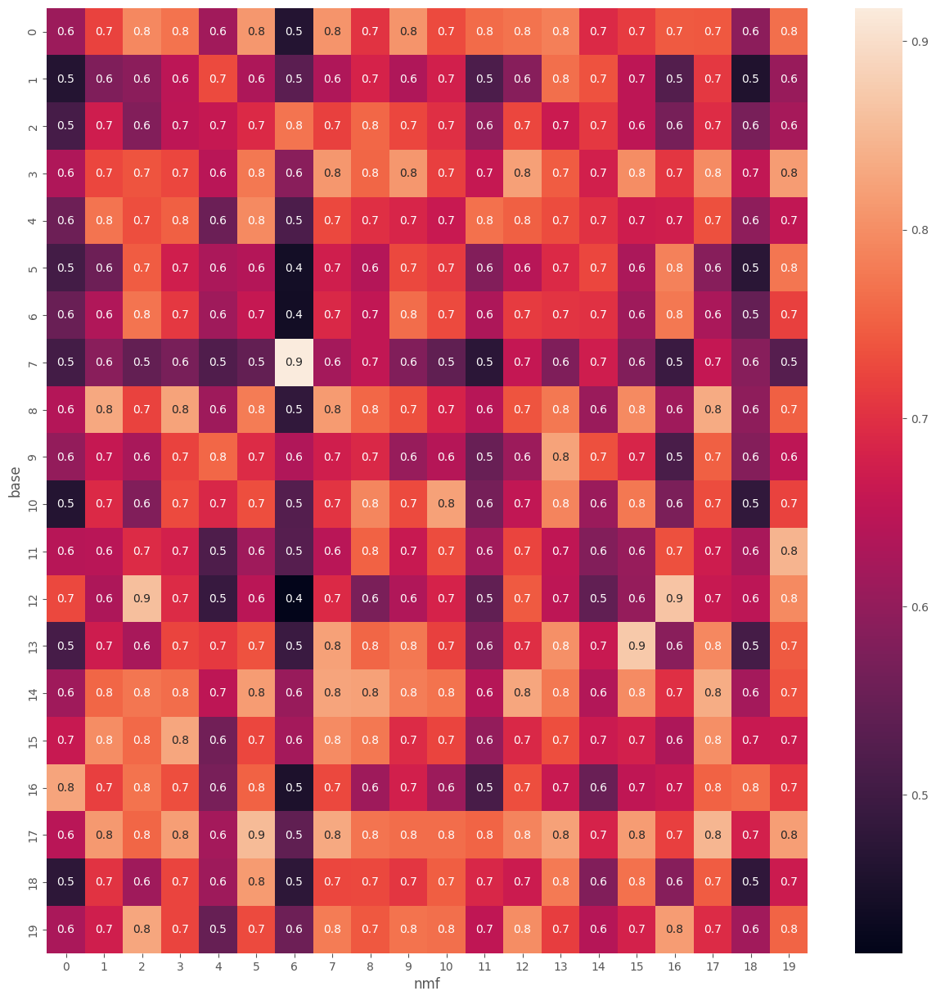

In [ ]:
plt.rcParams['figure.figsize']=15,15
topic_sim=[]
for i in range(20):
  v1 = ' '.join(topic_base[topic_base['topic']==i]['word_in topic'].values[:15])
  v1_emb=embed_bert_cls(v1, model, tokenizer)
#  print(v1)
  for m in range(20):
    sim_work=[]
    v2 = ' '.join(topic_nmf[topic_nmf['topic']==m]['topic_word'].values[:15])
    v2_emb=embed_bert_cls(v2, model, tokenizer)
    sim=similarity(v1_emb, v2_emb)
    sim_work.append(i)
    sim_work.append(m)
    sim_work.append(sim)
    topic_sim.append(sim_work)
#topic_sim
topic_sim_ds=pd.DataFrame(topic_sim,columns=['base','nmf','cos_sim'])
glue = topic_sim_ds.pivot(index='base', columns='nmf', values='cos_sim')
sns.heatmap(glue, annot=True, fmt=".1f")

In [ ]:
fig = px.imshow(glue,width=600, height=600)
fig.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
ds_line=pd.read_csv('/content/anekdot_topics.csv')
topic=pd.read_csv('/content/topic_nmf.csv')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
ds_line.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



,text_base,topic_base,probability_base,topic_bi,probability_bi,topic_nmf,probability_nmf,topic_lda,probability_lda
0,"Сразу после окончания Прямой линии, Путин пожа...",4,0.318902,17,0.287908,6.0,0.005586,13.0,0.690464
1,Это Аркадий. Аркадий попал в армию через посте...,9,0.578500,4,0.578520,19.0,0.002754,17.0,0.679510
2,Толкучка в атобусе. Автобус резко тормозит и ж...,13,0.262450,1,0.253221,1.0,0.034489,10.0,0.626270
3,"Интересно, гадалка уже догадалась, что я еду к...",11,0.578559,3,0.435849,19.0,0.004937,5.0,0.572086
4,"Идет одна бабка, на встречу другой и видит, чт...",5,0.212109,7,0.477250,4.0,0.041051,14.0,0.711752


In [ ]:
topic_nmf=pd.read_csv('/content/topic_nmf.csv')
topic_lda=pd.read_csv('/content/topic_lda.csv')
topic_base=pd.read_csv('/content/topic_base.csv')
topic_bi=pd.read_csv('/content/topic_bi.csv')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
topic_bi.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



,topic,word_in topic,weght_topic
0,0,спать,0.035042
1,0,красивый,0.026348
2,0,проблема,0.023558
3,0,народ,0.020903
4,0,заходить,0.020111


In [ ]:
topic[topic['topic']==0].head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



,topic,topic_word,topic_val
0,0,мама,6.855068
1,0,папа,5.233208
2,0,сынок,1.826546
3,0,сын,1.417577
4,0,вовочка,1.268411


In [ ]:
topic_nnmf_0=ds_line[ds_line['topic_nmf']==0]['text_base']

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
def joke_generator(data,topic_id,num,topic_model='topic_lda',):
  if topic_model=='topic_base':
    data_topic=topic_base
  if topic_model=='topic_bi':
    data_topic=topic_bi
  if topic_model=='topic_nmf':
    data_topic=topic_nmf
  if topic_model=='topic_lda':
    data_topic=topic_lda
  word_in_topic=data_topic[data_topic['topic']==topic_id]['topic_word'].values[:10]
  print('токены топика:',", ".join(word_in_topic) )
  print()

#  plotWordCloud_2(topic_number=topic_id, topics=data_topic)
  jokes=data[data[topic_model]==topic_id]['text_base'].values
  for i, joke in enumerate(jokes[:num]):
    print('анекдот',i,joke)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
joke_generator(ds_line,13,21,'topic_nmf')

токены топика: говорить, правда, привет, слышать, умный, слушать, давать, понимать, красивый, секс

анекдот 0 О взяточнике: умел правильно оценить ситуацию
анекдот 1 Пожалуйста, не материтесь, говорите культурно. Например: "В информационно-волновой памяти вашей матушки есть воспоминания и обо мне"
анекдот 2 Правда, проверенная на детекторе лжи, оказалась далеко не голой
анекдот 3 Роза Марковна провела двадцать лет в счастливом законном браке, чего, правда, нельзя сказать о пяти ее сменившихся супругах
анекдот 4 Ты говоришь так, будто через 15 секунд твой нос будет сломан
анекдот 5 - Вот, говорят, что президент смотрит новости на Первом канале?- Да, все верно.- А зачем?- Чтобы хоть как-то отвлечься от реальной жизни
анекдот 6 Наша жизнь - окончательна и бесповоротна
анекдот 7 Двухлетняя дочка ноет над коробкой печенек. Говорим ей:- Прочитай, что написано на коробке - тогда откроем.Она с энтузиазмом водит пальчиком по корейским иероглифам и говорит:- Очень вкусно. Надо кушать
анекдот 8 М

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
print(ds_line.groupby(['topic_base'])['text_base'].count())
print(ds_line.groupby(['topic_bi'])['text_base'].count())
print(ds_line.groupby(['topic_nmf'])['text_base'].count())
print(ds_line.groupby(['topic_lda'])['text_base'].count())

topic_base
0      4512
1     10688
2      5252
3      3670
4      5164
5      7978
6      4595
7      4779
8      8453
9      7659
10     3990
11     5736
12    10407
13     4289
14     4053
15     5440
16     9414
17     5015
18     3896
19     6661
Name: text_base, dtype: int64
topic_bi
0      3370
1     10477
2      4832
3      3428
4      4706
5      6050
6      9526
7      4502
8      3172
9      4730
10     6862
11     5660
12    11176
13     8359
14     3416
15     4817
16     4913
17     4555
18     7781
19     9319
Name: text_base, dtype: int64
topic_nmf
0.0      2957
1.0      4152
2.0      6385
3.0      5072
4.0      4186
5.0      2026
6.0      7558
7.0      2013
8.0      4489
9.0      4078
10.0     2774
11.0     3531
12.0     2191
13.0     2746
14.0     7427
15.0     2535
16.0     5287
17.0     2092
18.0     4185
19.0    45967
Name: text_base, dtype: int64
topic_lda
0.0     12313
1.0      4736
2.0      2017
3.0      2834
4.0     17588
5.0      2909
6.0      2655
7.0      296

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Покажим в сравнении топики для высокого значения косинусного расстояния

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



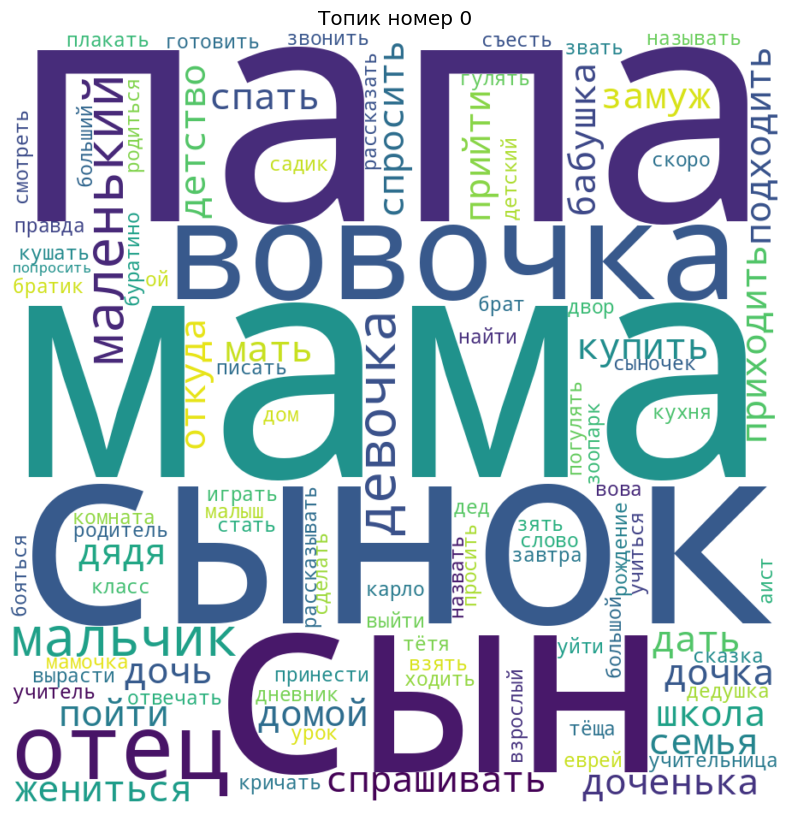

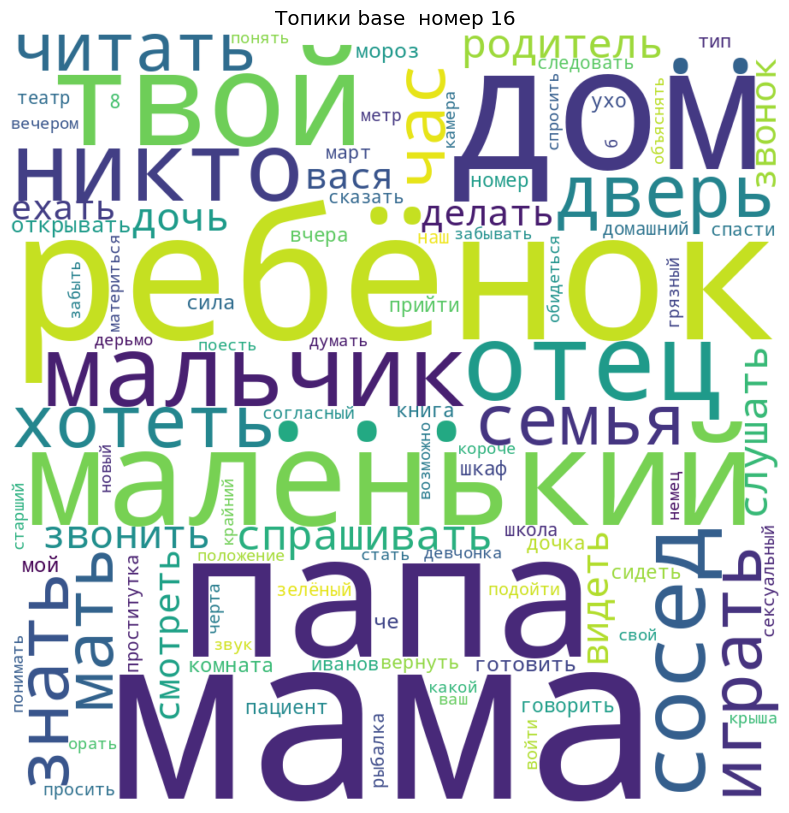

In [ ]:
plotWordCloud_2(topic_number=0, topics=topic_nmf)
plotWordCloud(topic_number=16, topics=lda_topics_base,head='Топики base ')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



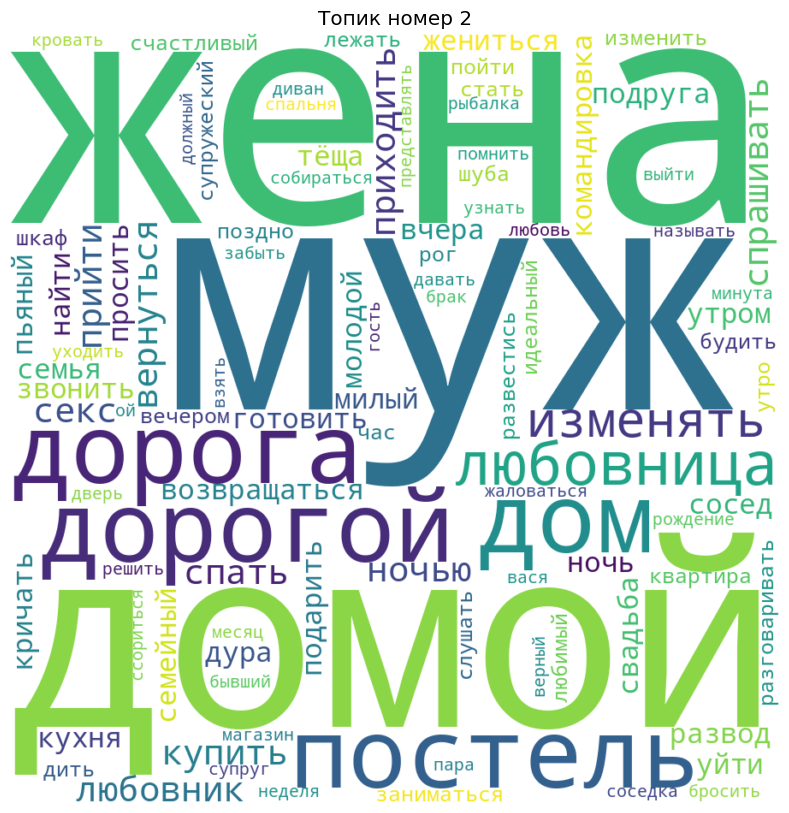

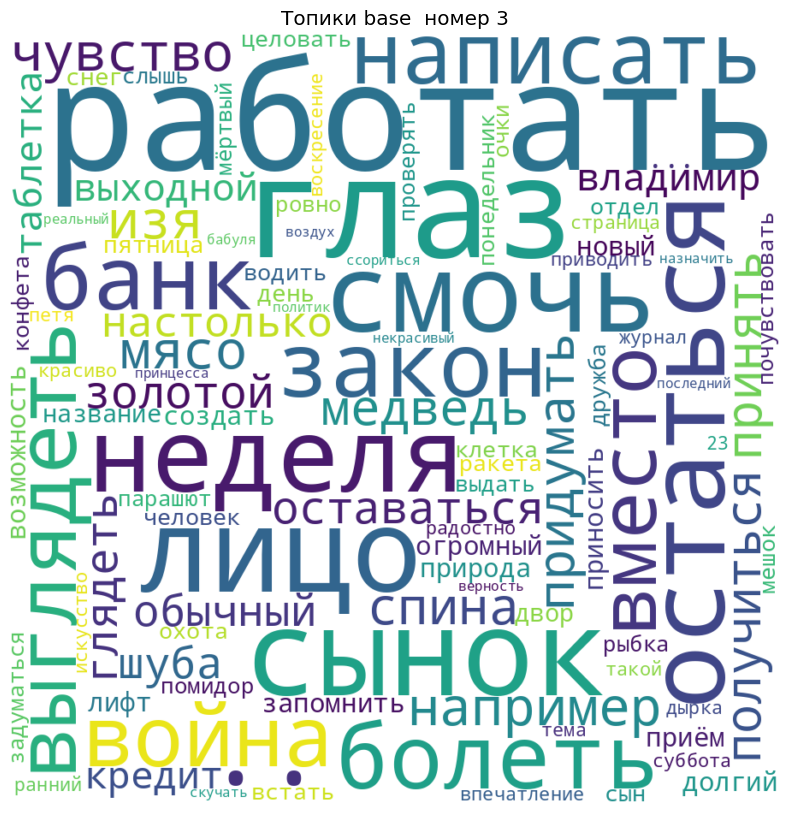

In [ ]:
plotWordCloud_2(topic_number=2, topics=topic_nmf)
plotWordCloud(topic_number=3, topics=lda_topics_base,head='Топики base ')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



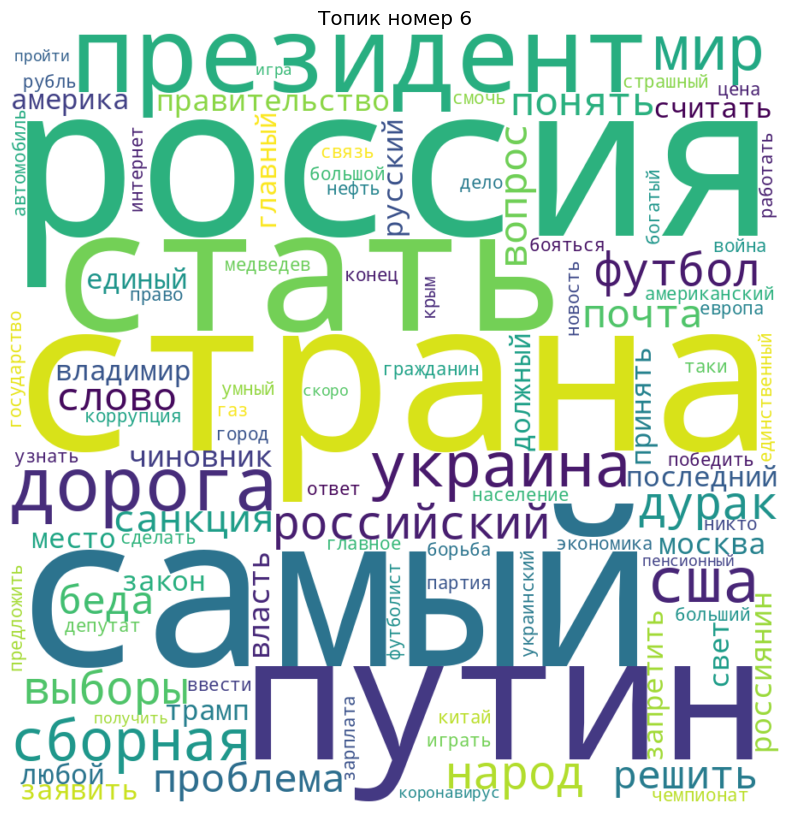

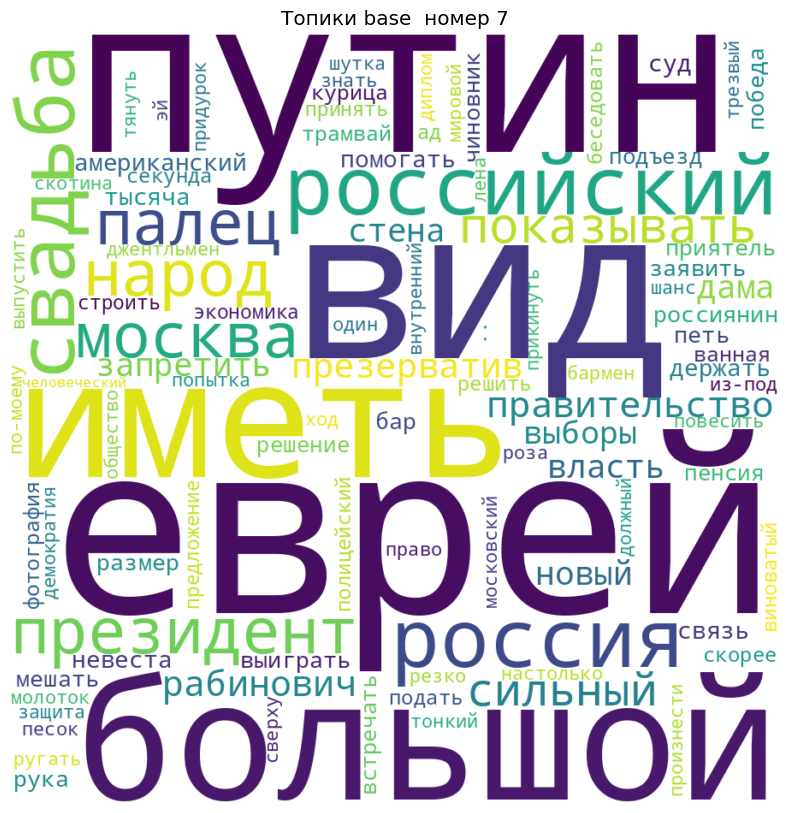

In [ ]:
plotWordCloud_2(topic_number=6, topics=topic_nmf)
plotWordCloud(topic_number=7, topics=lda_topics_base,head='Топики base ')